In [2]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import umap
import random
from matplotlib.image import BboxImage
from matplotlib.transforms import Bbox, TransformedBbox
from sklearn.neighbors import KNeighborsClassifier
import pickle
from tqdm import tqdm
from utils import features_dpt_entropy, features_homology_dpt_entropy, features_vector, features_ripley_dpt_v2, preprocessing, features_avg_connection_dpt
import utils as util
import pandas as pd
import glob
from sklearn.decomposition import PCA
import simdata_generator as dataset
import os 
from sknetwork.clustering import Louvain
from sklearn.neighbors import kneighbors_graph
import scanpy_modified as scanpy
from anndata import AnnData
import scanpy as sp

In [3]:
META_SCORES = list(np.load('data/simulated_metascores_12000.npy'))
npy_sim = np.array(META_SCORES)
metric = 'euclidean'
seed = 1
n_neighbors = 50
min_dist = 0.6
figsize = 5
repeat = 3000
scaler = StandardScaler()
tmp_np = scaler.fit_transform(npy_sim)
tmp_reducer = umap.UMAP(n_neighbors=n_neighbors, n_components=2,random_state=seed,min_dist=min_dist, metric=metric)
embedding = tmp_reducer.fit_transform(tmp_np)

classes = ['Clear Clusters','Clear Trajectory','Noisy Trajectory','Noisy Clusters']
c1 = [0 for i in range(repeat)]
c2 = [1 for i in range(repeat)]
c3 = [0 for i in range(repeat)]
c4 = [1 for i in range(repeat)]

c = c1+c2+c3+c4

neigh = KNeighborsClassifier(n_neighbors=100)
neigh.fit(embedding, c)

b = neigh.predict(embedding)
p = neigh.predict_proba(embedding)[:,1]

d:\Anaconda3\envs\scVenv\lib\site-packages\sklearn\neighbors\_classification.py:211: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


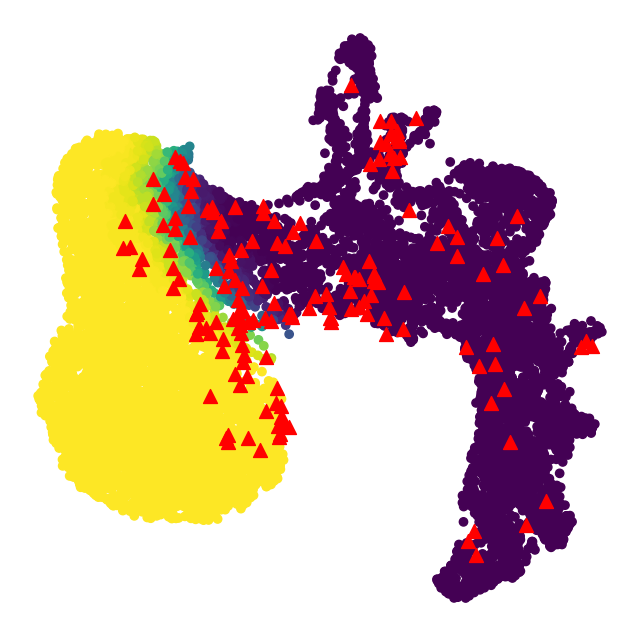

In [4]:
with open('data/real_data_dict.pkl', 'rb') as file:
    loaded_dict = pickle.load(file)
all_files = list(loaded_dict.keys())
scores = []
for f in all_files:
    scores.append(loaded_dict[f]['score'])
npy_real = np.array(scores)

tmp_real = scaler.transform(npy_real)
np_real_emb = tmp_reducer.transform(tmp_real)

plt.figure(figsize=(8,8))
plt.scatter(embedding[:,0],embedding[:,1], c = p, alpha = 1)
plt.scatter(np_real_emb[:,0],np_real_emb[:,1], c = 'r', s = 100,  marker="^")
plt.axis('off')
plt.show()

coordinates = {}
for f, emb in zip(all_files,np_real_emb):
    coordinates[f] = emb

data/benchmarkfiles\aging-hsc-old_kowalczyk.rds.csv


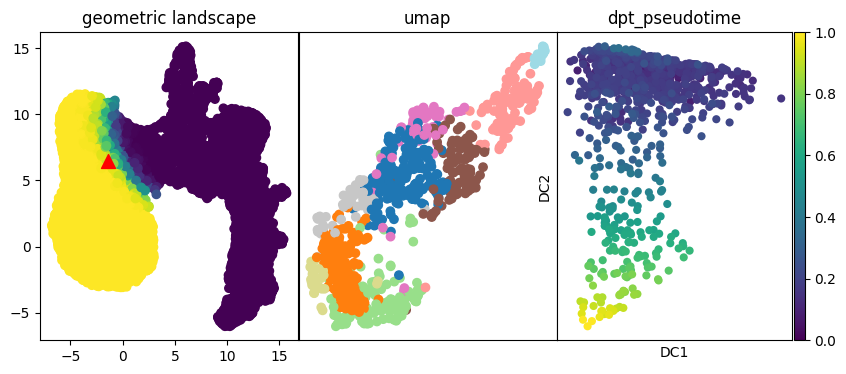

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\aging-hsc-young_kowalczyk.rds.csv


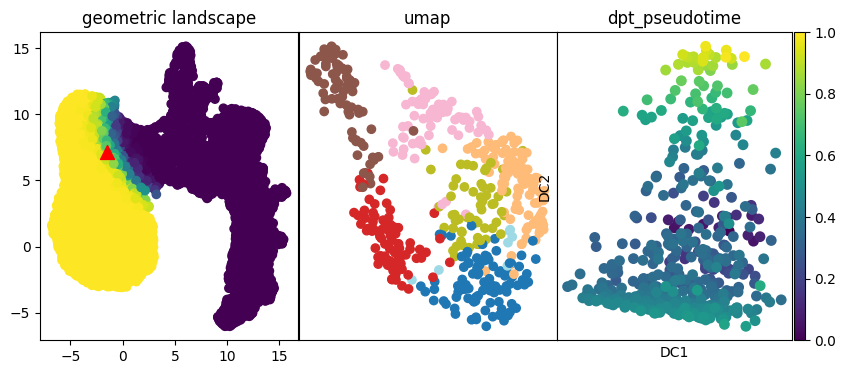

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\blastocyst-monkey_nakamura.rds.csv


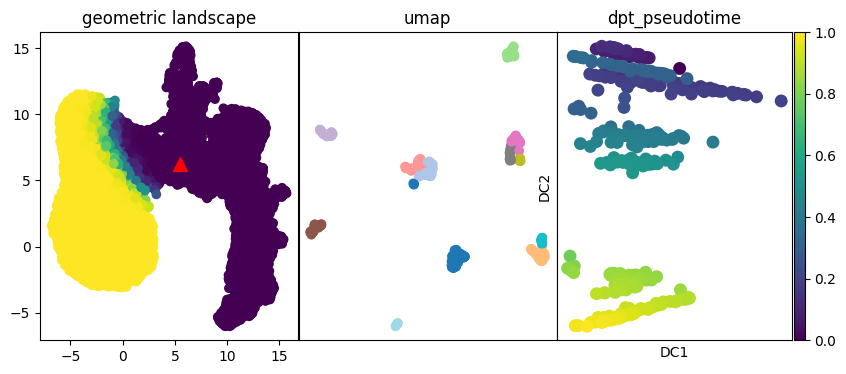

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\bone-marrow-mesenchyme-erythrocyte-differentiation_mca.rds.csv


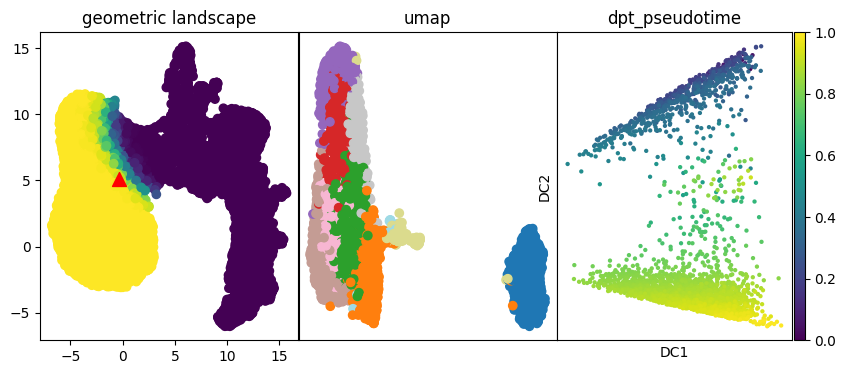

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\cell-cycle_buettner.rds.csv


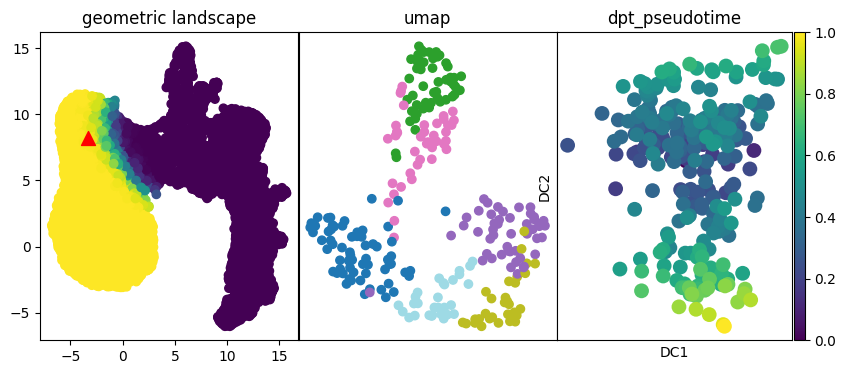

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\cell-cycle_leng.rds.csv


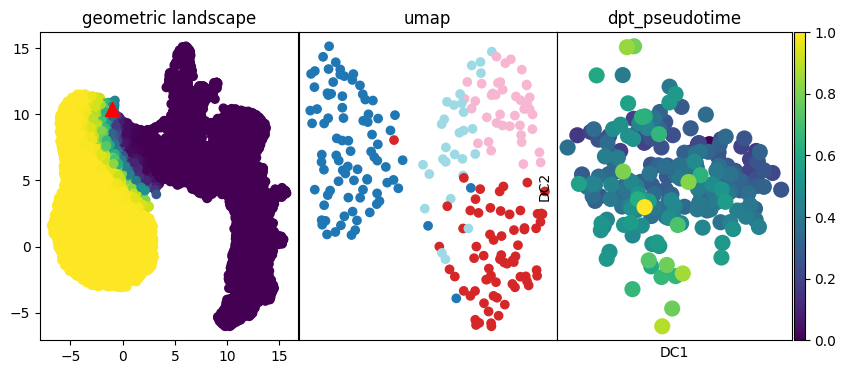

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\cellbench-SC1_luyitian.rds.csv


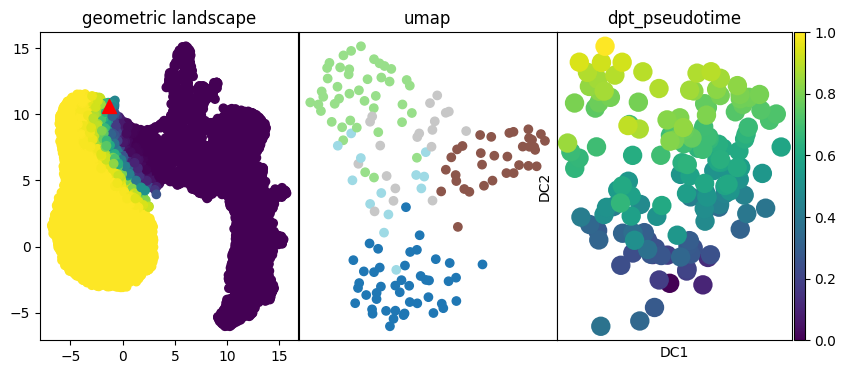

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\cellbench-SC2_luyitian.rds.csv


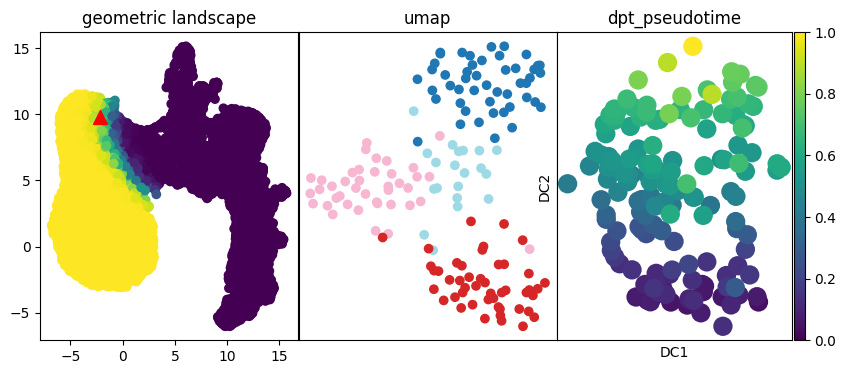

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\cellbench-SC3_luyitian.rds.csv


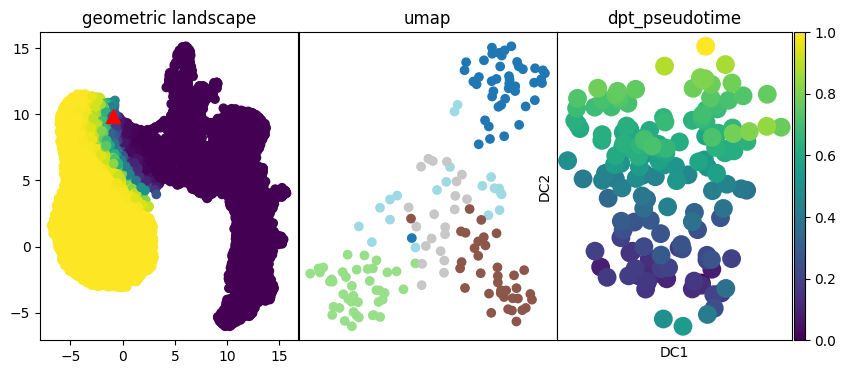

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\cellbench-SC4_luyitian.rds.csv


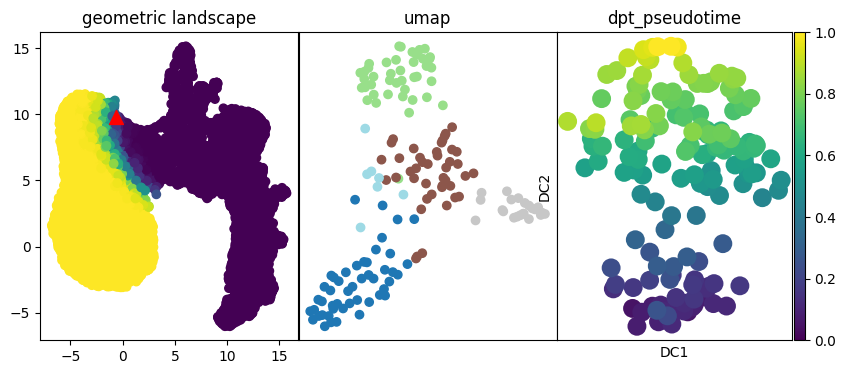

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\cortical-interneuron-differentiation_frazer.rds.csv


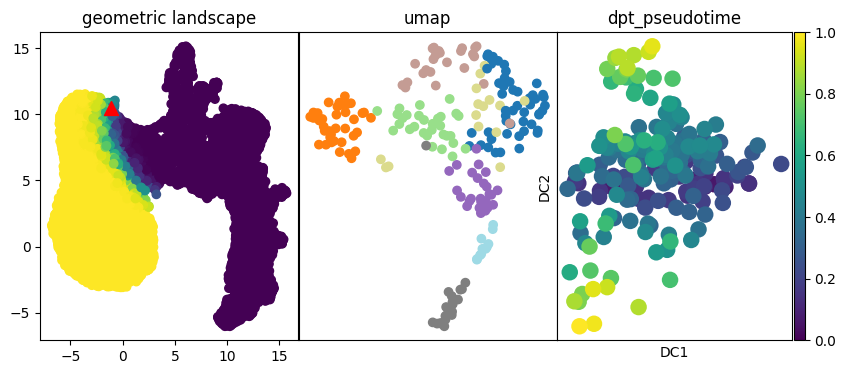

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\dentate-gyrus-neurogenesis_hochgerner.rds.csv


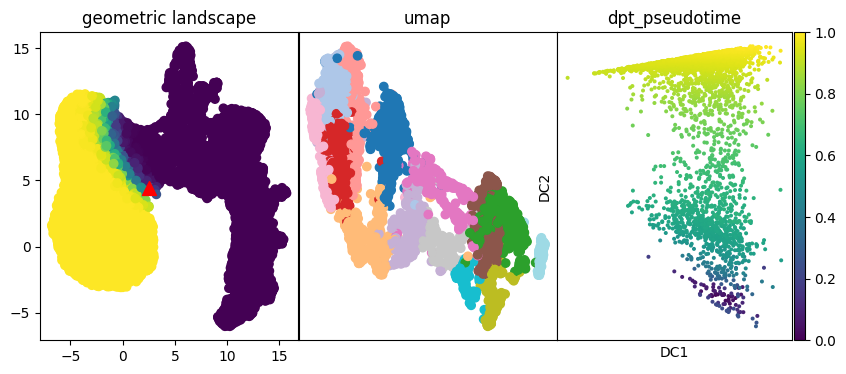

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\developing-dendritic-cells_schlitzer.rds.csv


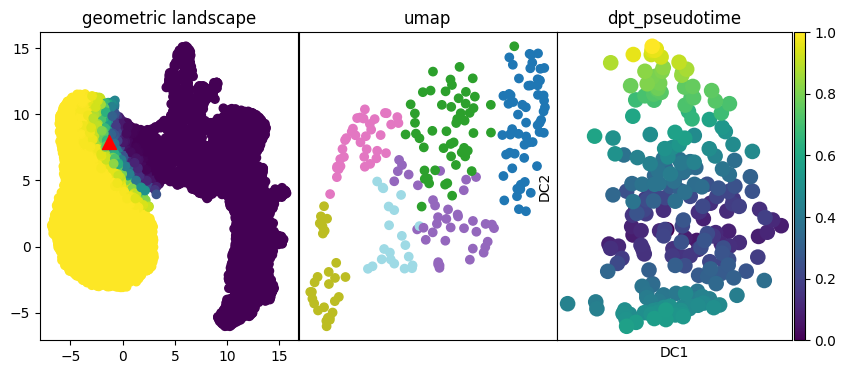

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\distal-lung-epithelium_treutlein.rds.csv


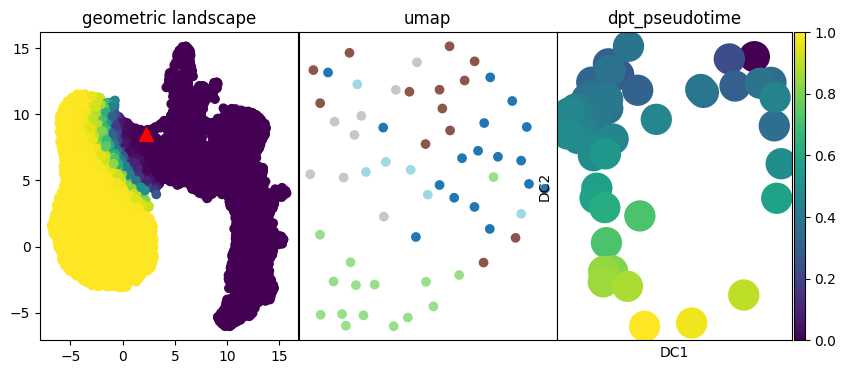

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\embronic-mesenchyme-neuron-differentiation_mca.rds.csv


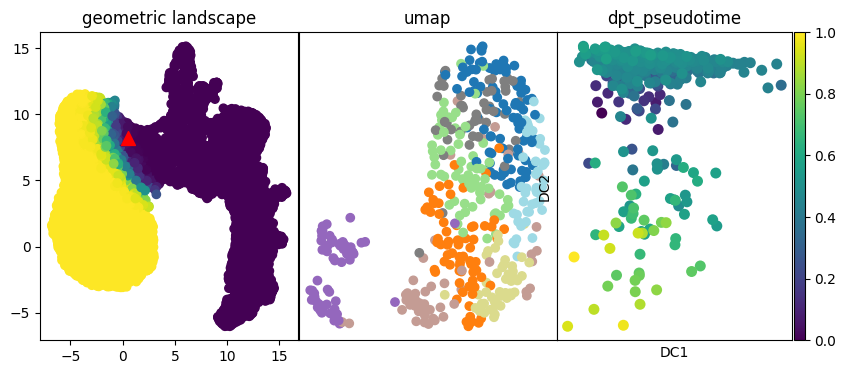

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\embryonic-mesenchyme-stromal-cell-cxcl14-cxcl12-axis_mca.rds.csv


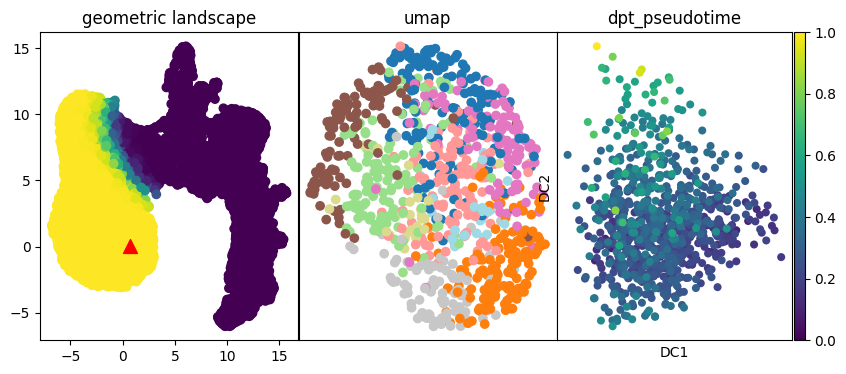

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\epiblast-monkey_nakamura.rds.csv


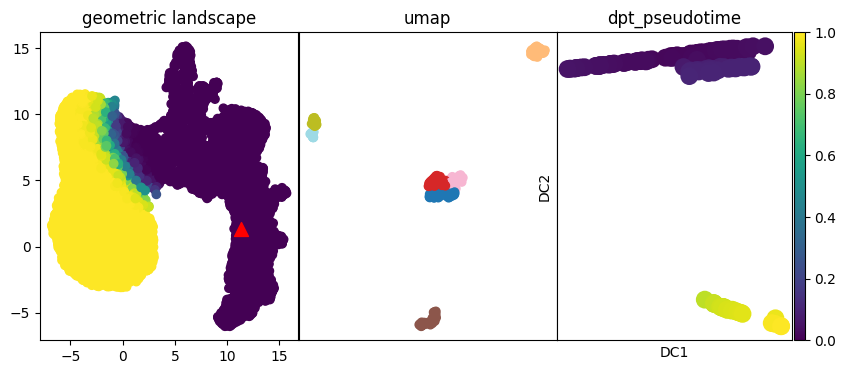

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\epidermis-hair-IFE_joost.rds.csv


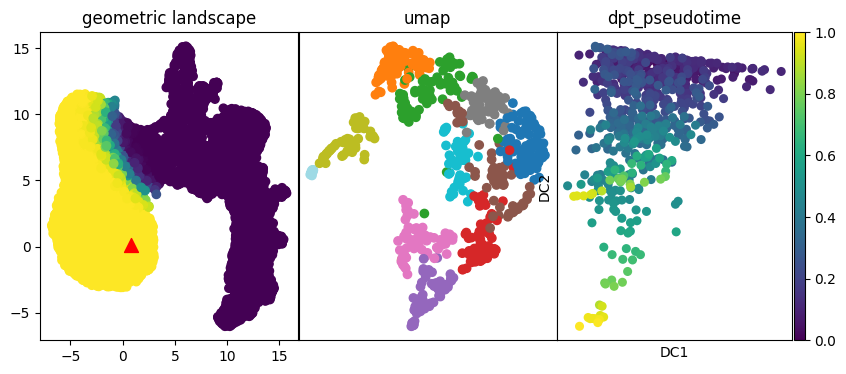

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\epidermis-hair-spatial_joost.rds.csv


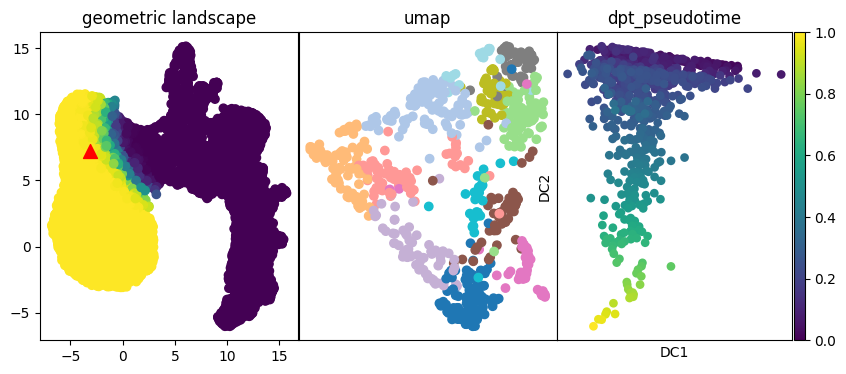

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\epidermis-hair-uHF_joost.rds.csv


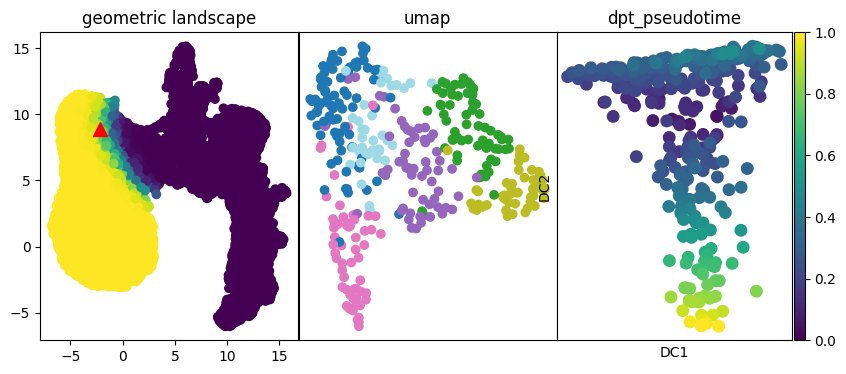

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\fetal-liver-fetal-hematopoiesis_mca.rds.csv


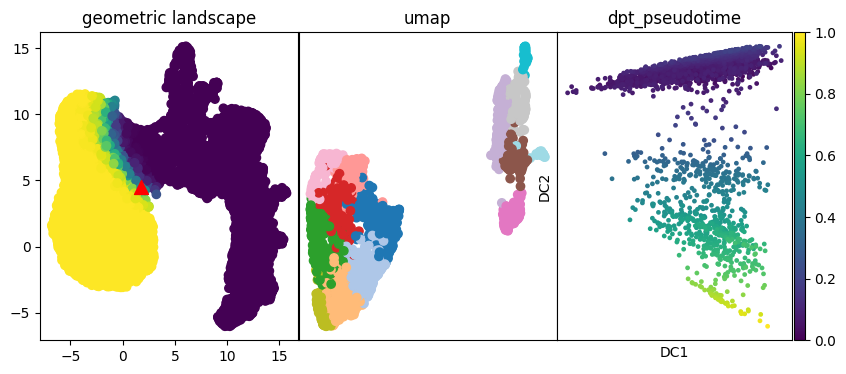

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\fibroblast-reprogramming_treutlein.rds.csv


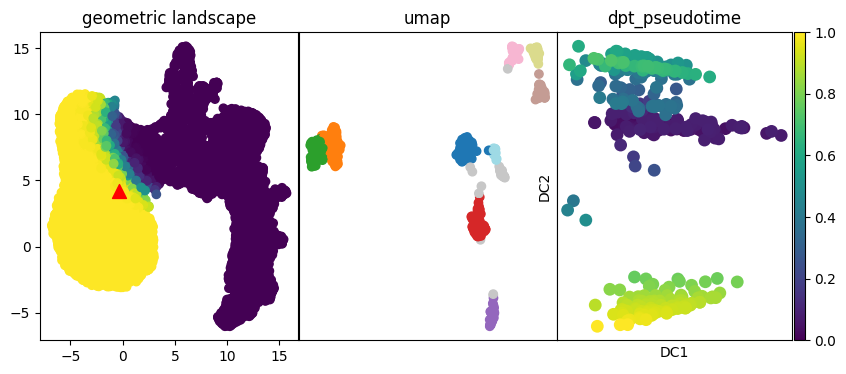

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\germline-human-both_guo.rds.csv


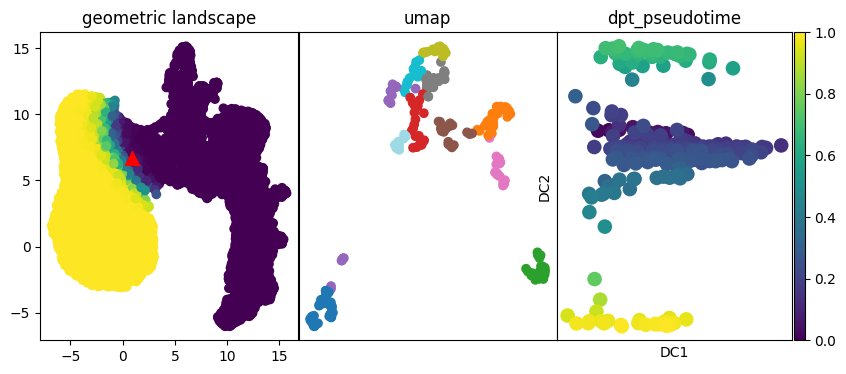

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\germline-human-female-weeks_li.rds.csv


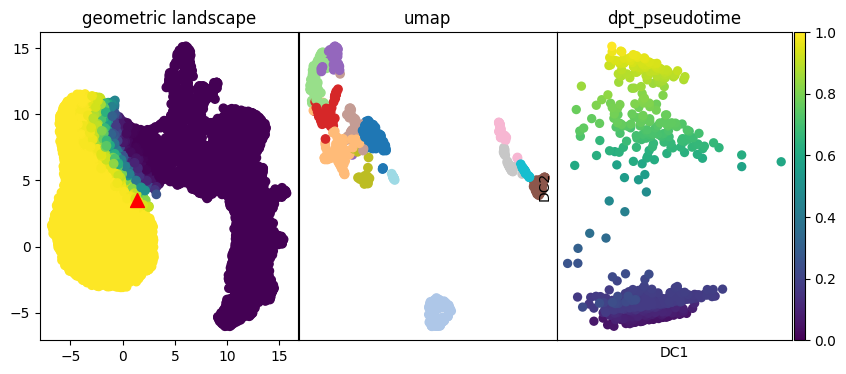

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\germline-human-female_guo.rds.csv


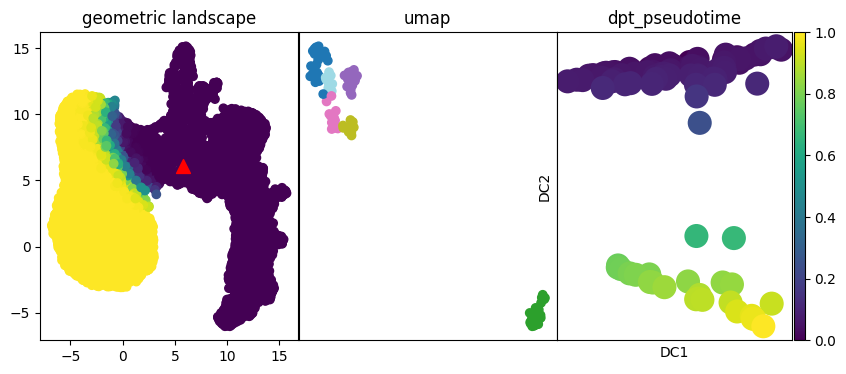

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\germline-human-female_li.rds.csv


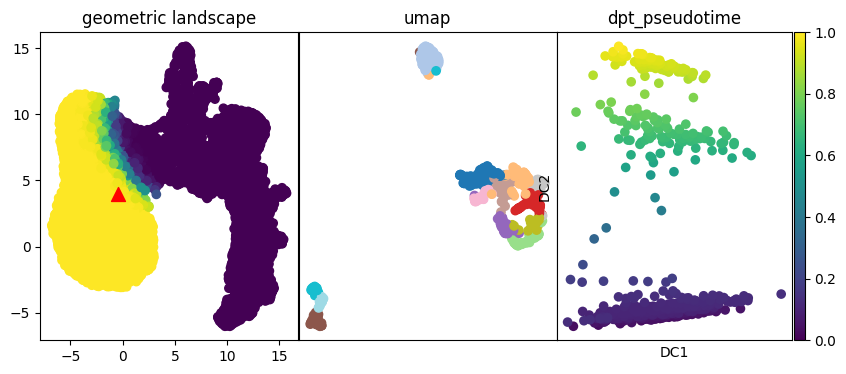

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\germline-human-male-weeks_li.rds.csv


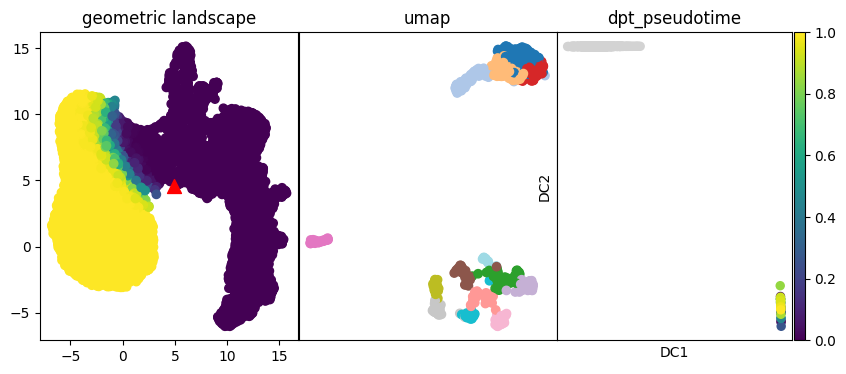

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\germline-human-male_guo.rds.csv


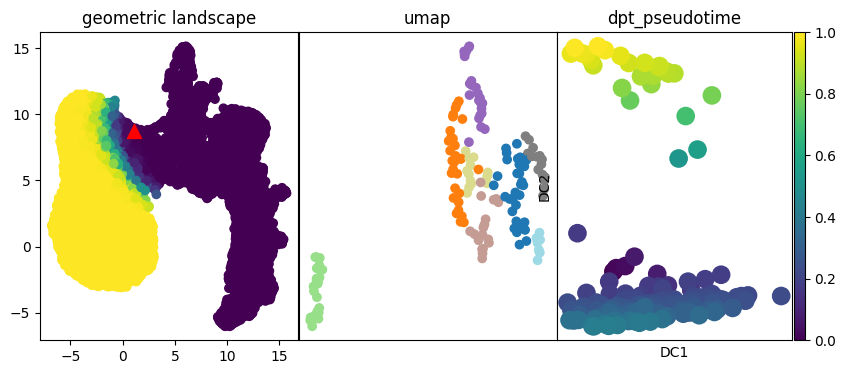

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\germline-human-male_li.rds.csv


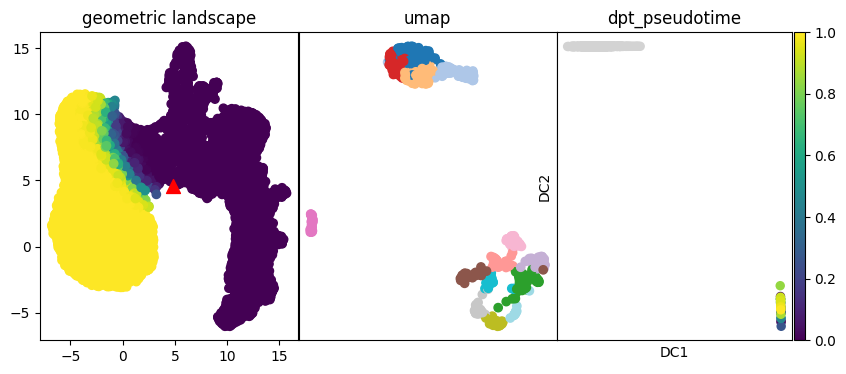

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\hematopoiesis-clusters_olsson.rds.csv


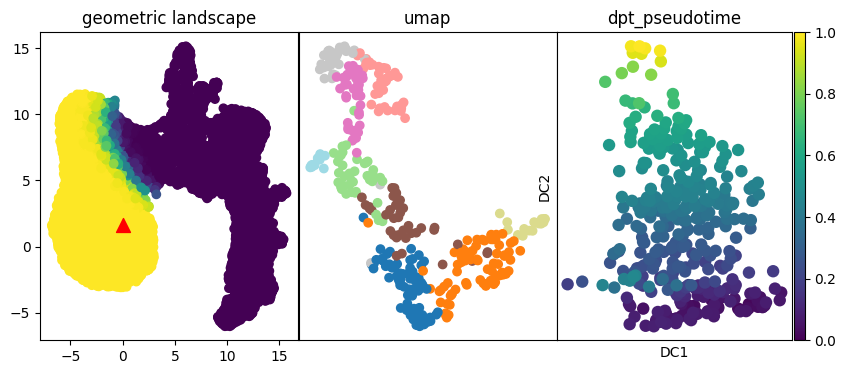

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\hematopoiesis-gates_olsson.rds.csv


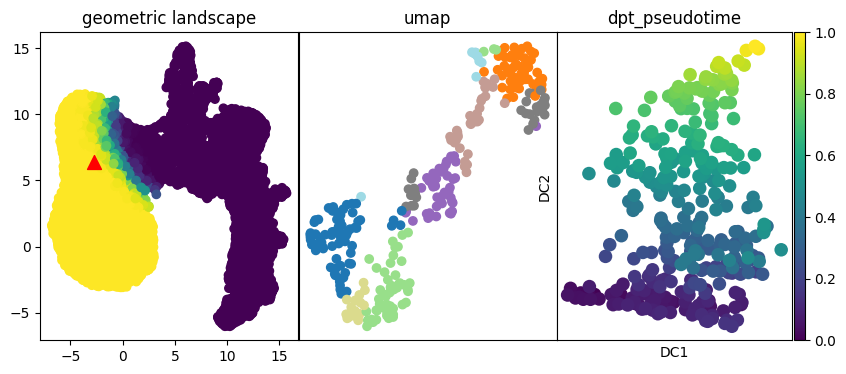

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\hepatoblast-differentiation_yang.rds.csv


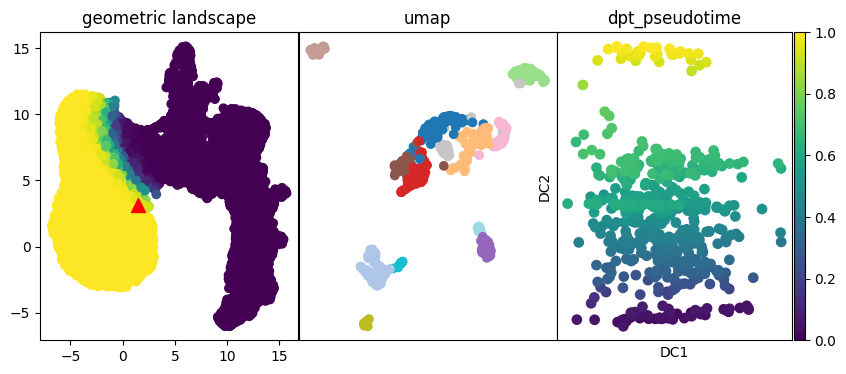

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\human-embryos_petropoulos.rds.csv


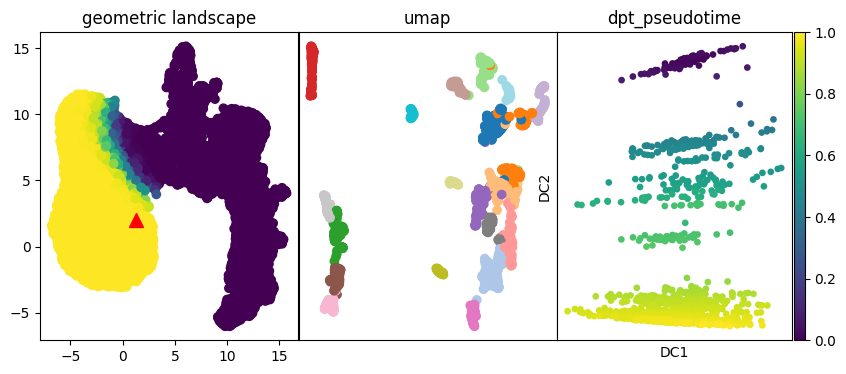

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\ICM-monkey_nakamura.rds.csv


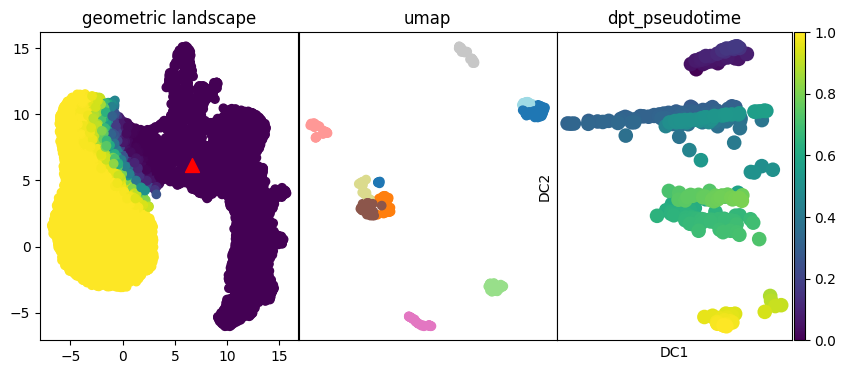

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\kidney-bursh-border-to-s1_mca.rds.csv


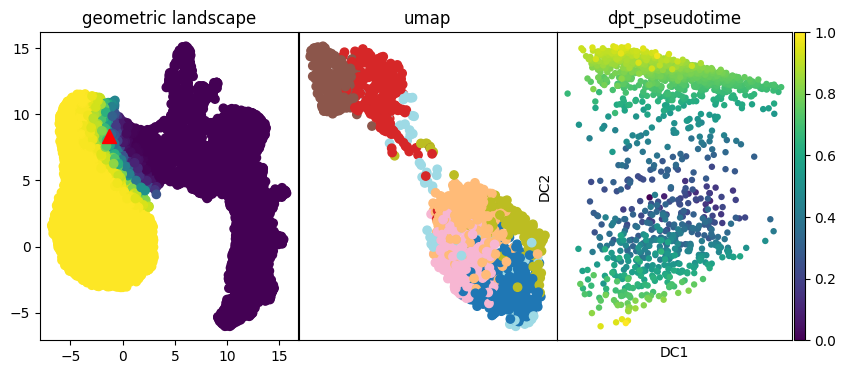

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\kidney-collecting-duct-clusters_park.rds.csv


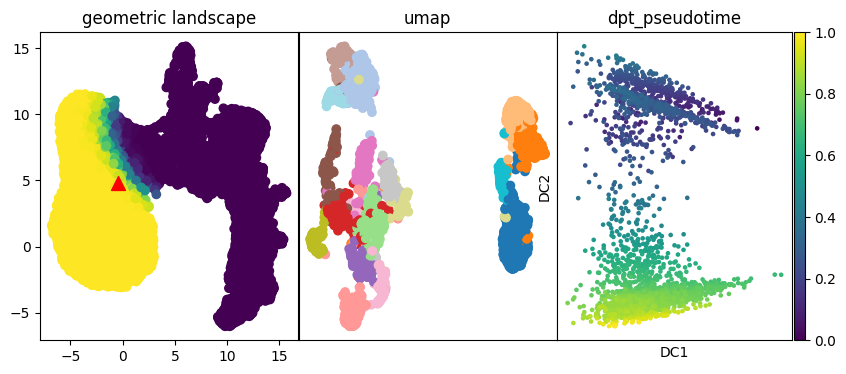

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\kidney-collecting-duct-subclusters_park.rds.csv


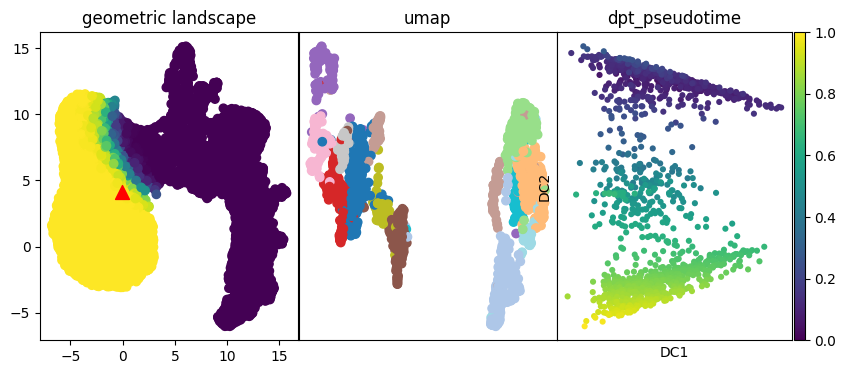

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\kidney-distal-convoluted-tubule_mca.rds.csv


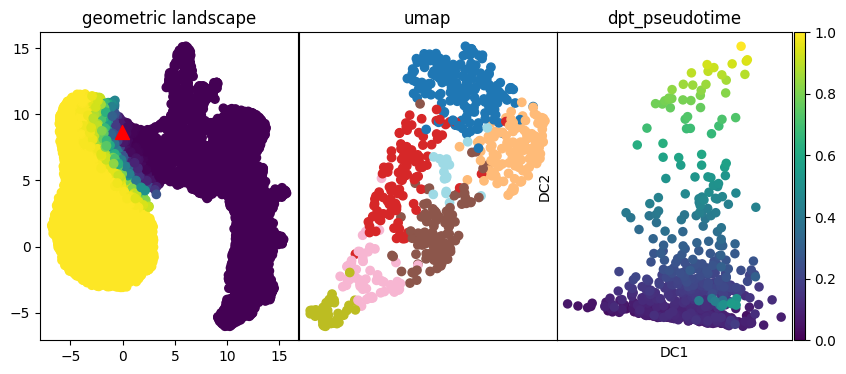

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\macrophage-salmonella_saliba.rds.csv


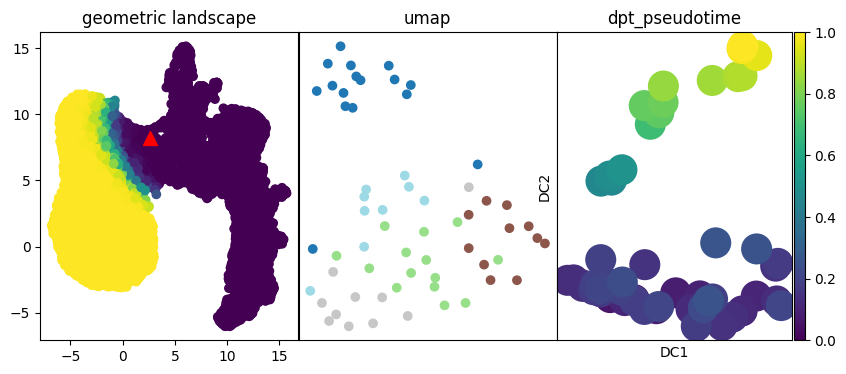

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mammary-gland-involution-endothelial-cell-aqp1-gradient_mca.rds.csv


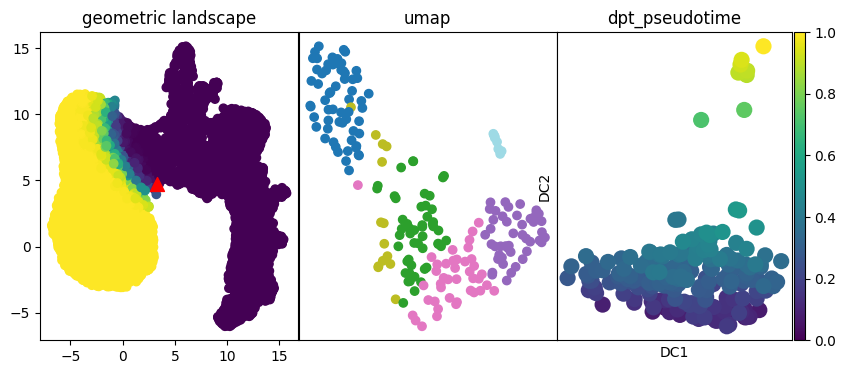

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mESC-differentiation_hayashi.rds.csv


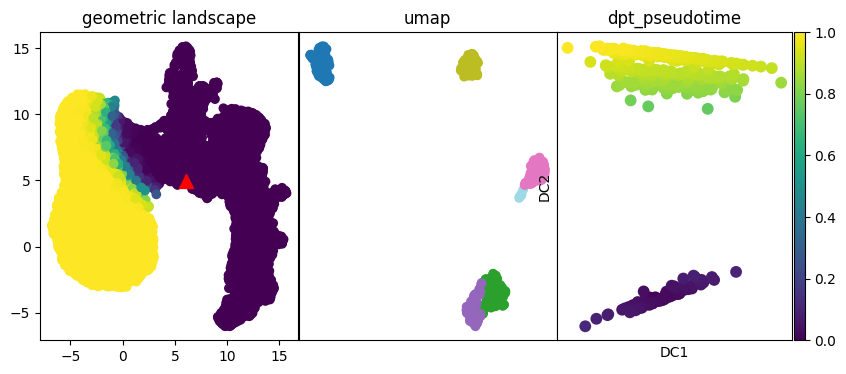

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mesoderm-development_loh.rds.csv


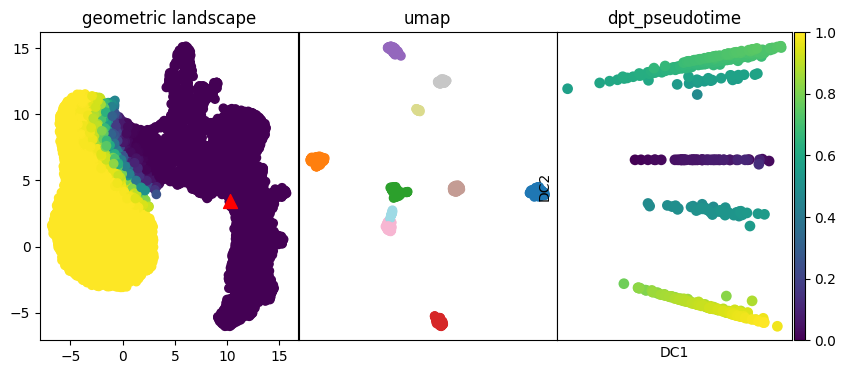

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mouse-cell-atlas-combination-1.rds.csv


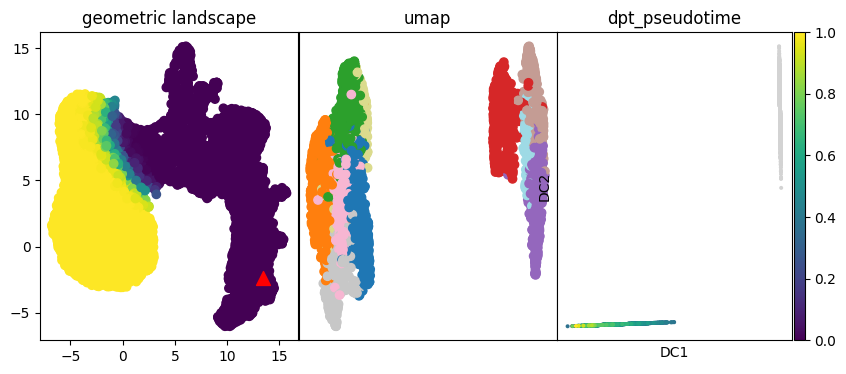

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mouse-cell-atlas-combination-10.rds.csv


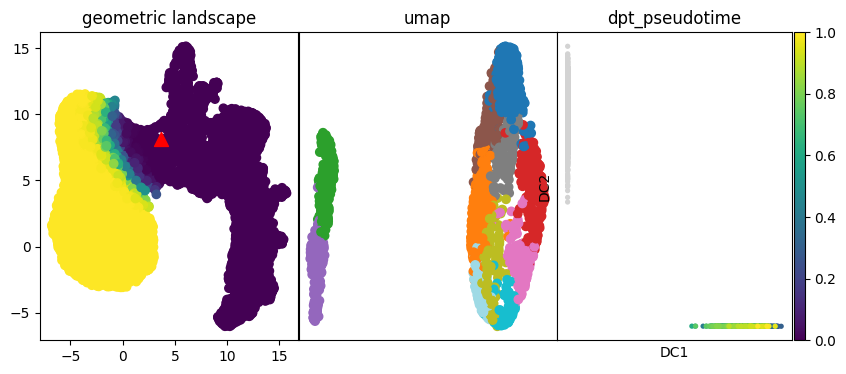

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mouse-cell-atlas-combination-2.rds.csv


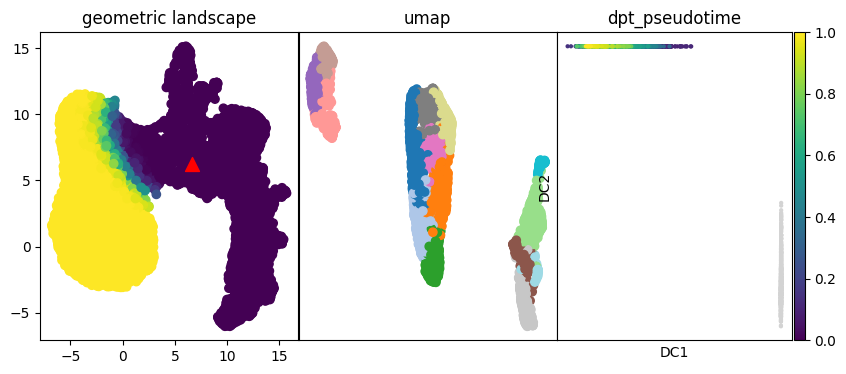

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mouse-cell-atlas-combination-3.rds.csv


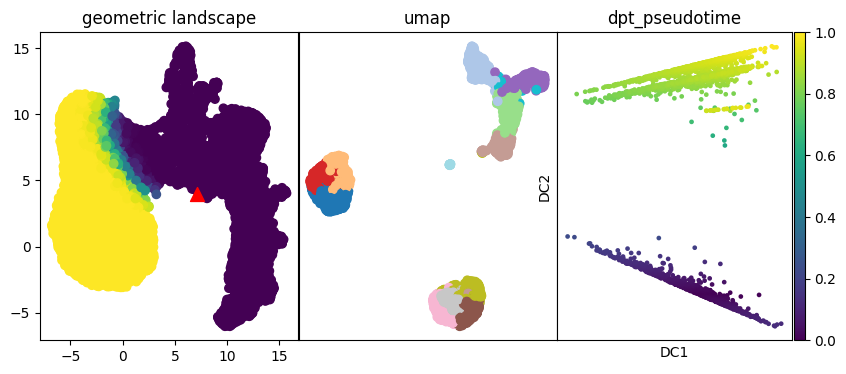

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mouse-cell-atlas-combination-4.rds.csv


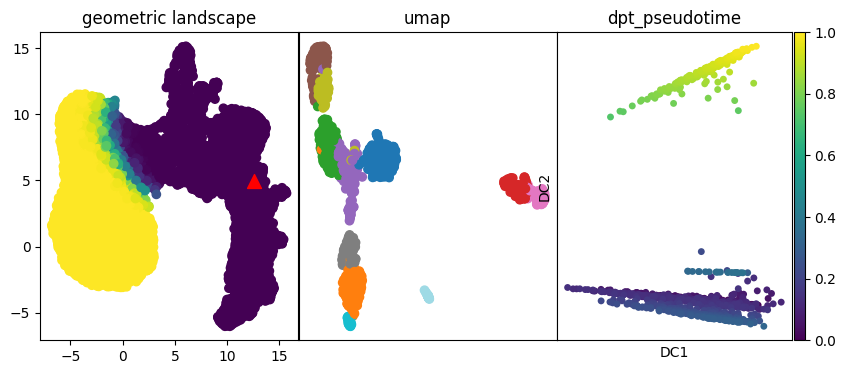

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mouse-cell-atlas-combination-5.rds.csv


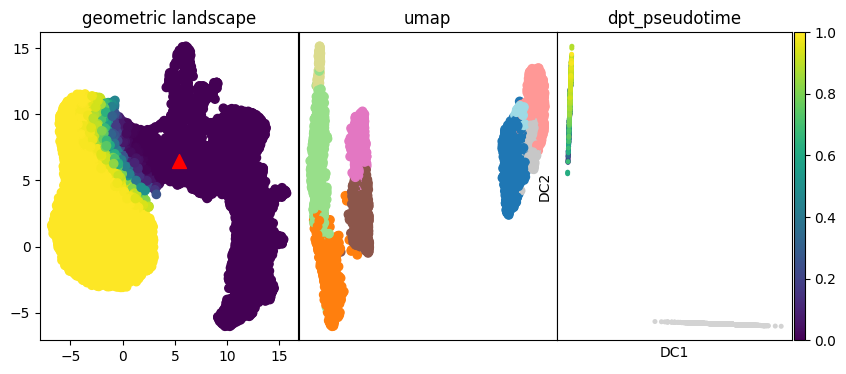

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mouse-cell-atlas-combination-6.rds.csv


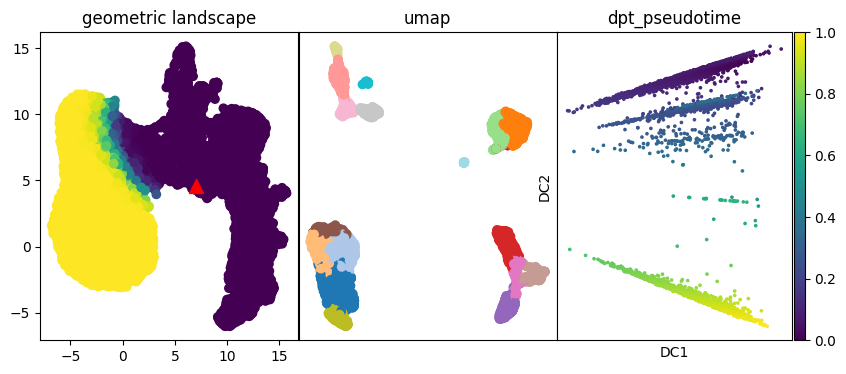

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mouse-cell-atlas-combination-7.rds.csv


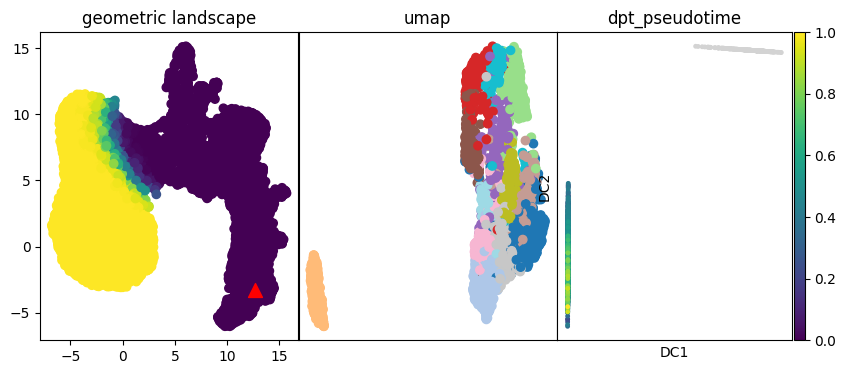

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\mouse-cell-atlas-combination-8.rds.csv


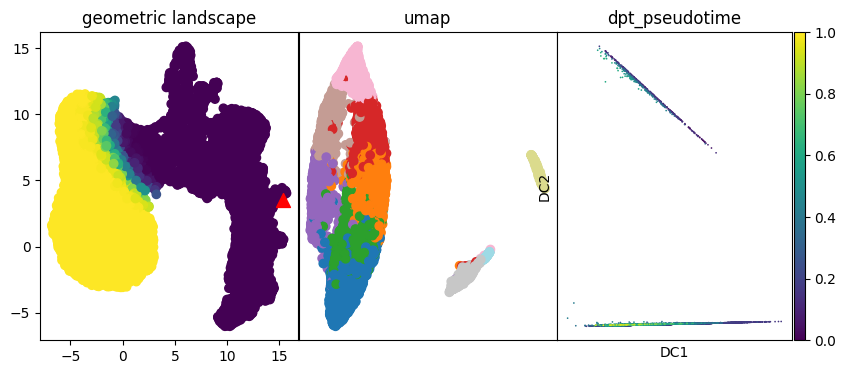

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\myoblast-differentiation_trapnell.rds.csv


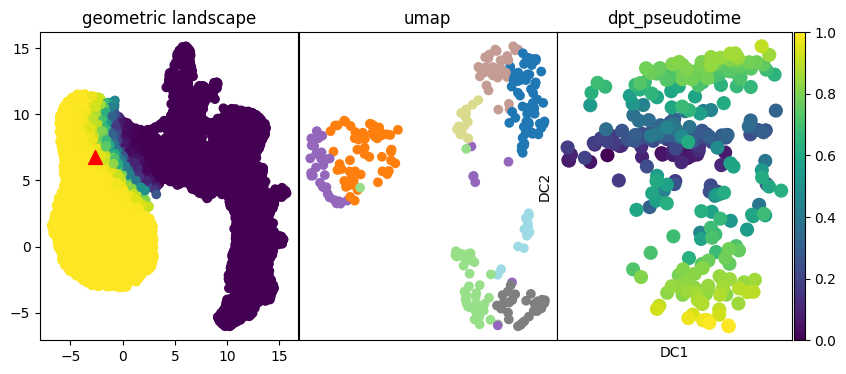

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\neonatal-inner-ear-all_burns.rds.csv


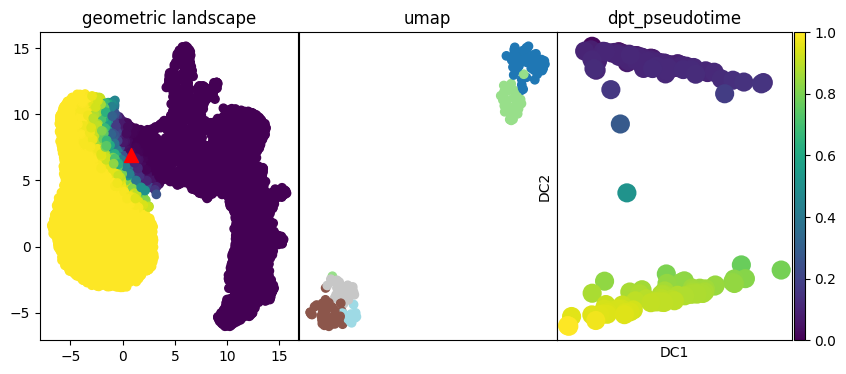

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\neonatal-inner-ear-SC-HC_burns.rds.csv


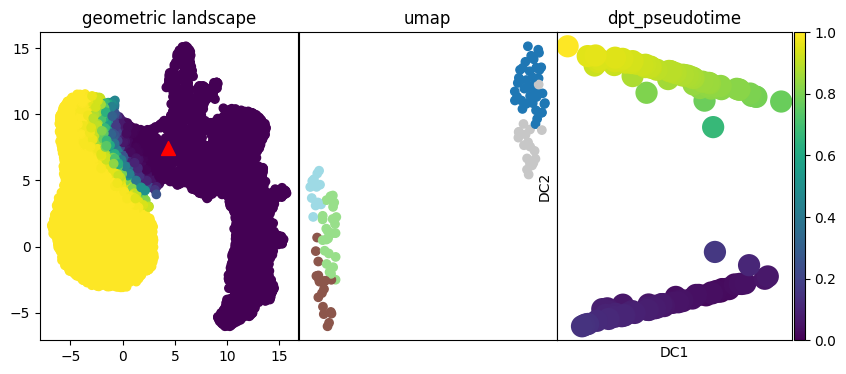

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\neonatal-inner-ear-TEC-HSC_burns.rds.csv


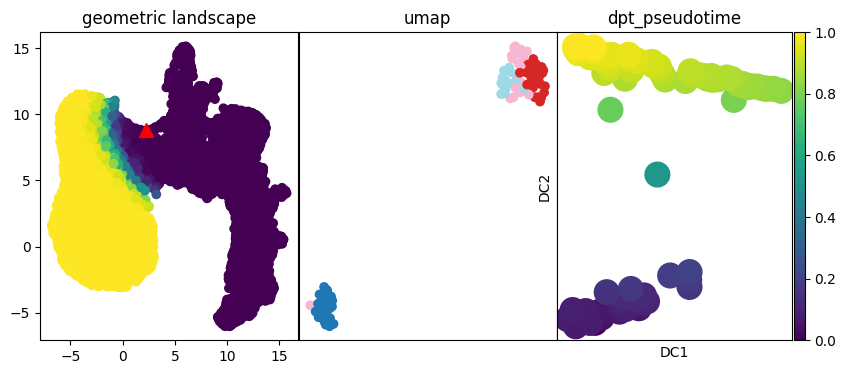

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\neonatal-inner-ear-TEC-SC_burns.rds.csv


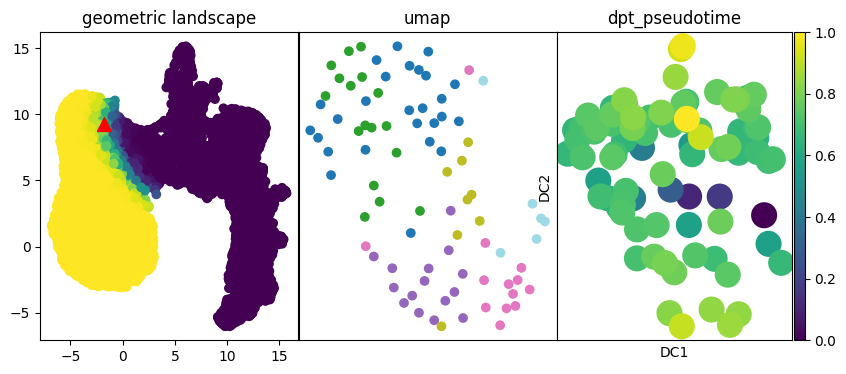

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\neonatal-rib-cartilage_mca.rds.csv


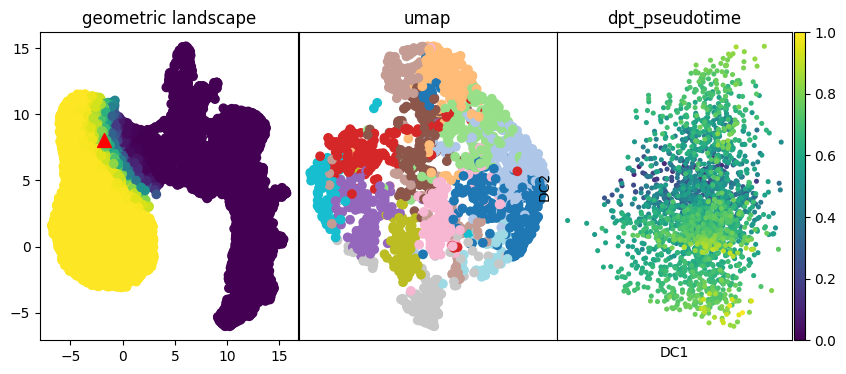

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\NKT-differentiation_engel.rds.csv


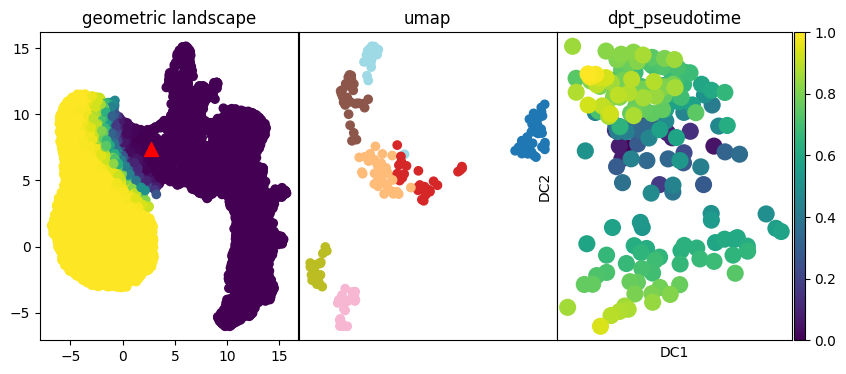

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\olfactory-projection-neurons-DA1_horns.rds.csv


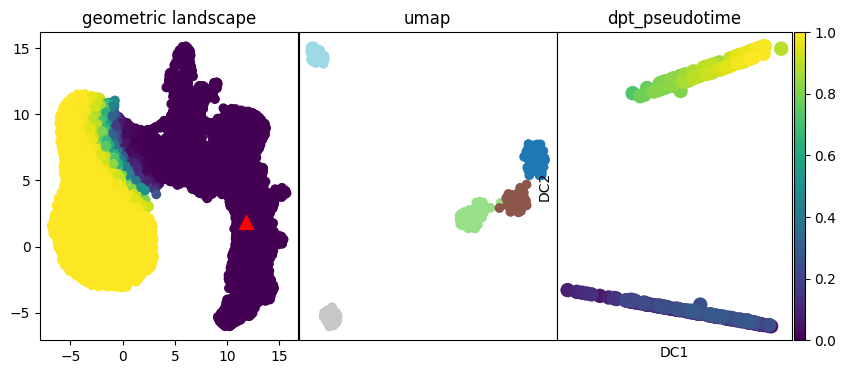

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\olfactory-projection-neurons-DC3_VA1d_horns.rds.csv


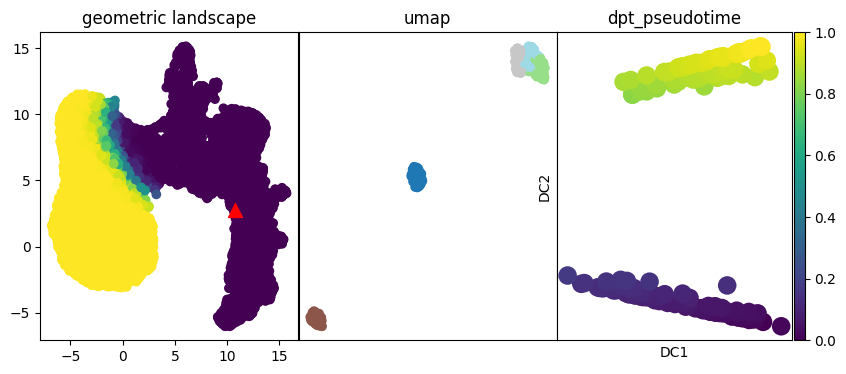

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\olfactory-projection-neurons_horns.rds.csv


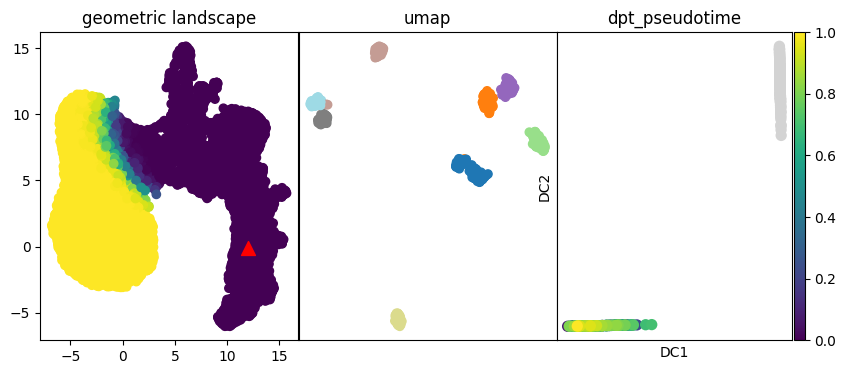

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\oligodendrocyte-differentiation-clusters_marques.rds.csv


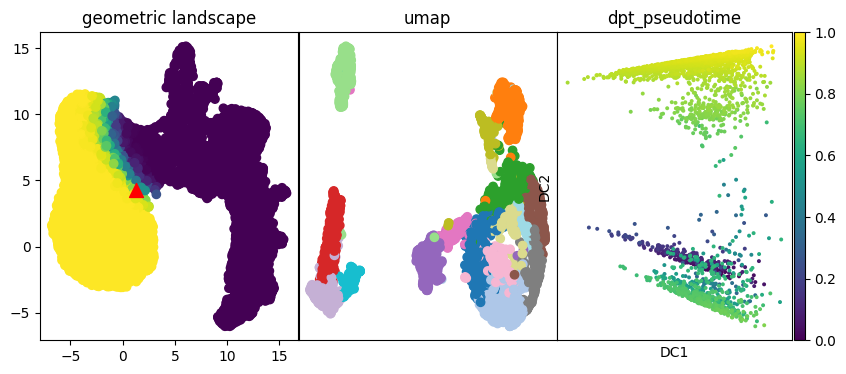

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\oligodendrocyte-differentiation-subclusters_marques.rds.csv


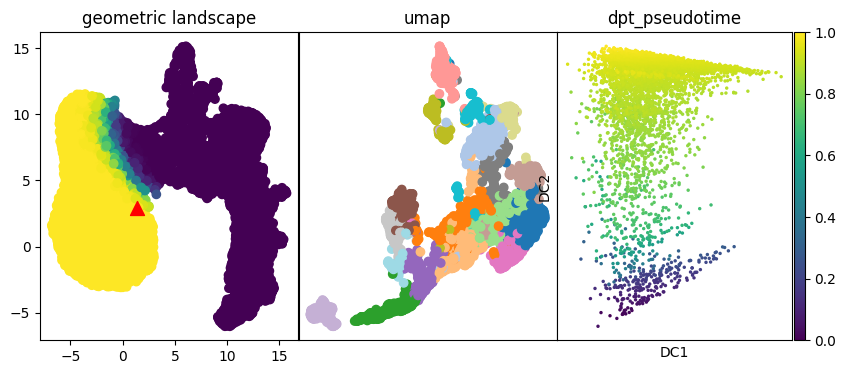

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\pancreatic-alpha-cell-maturation_zhang.rds.csv


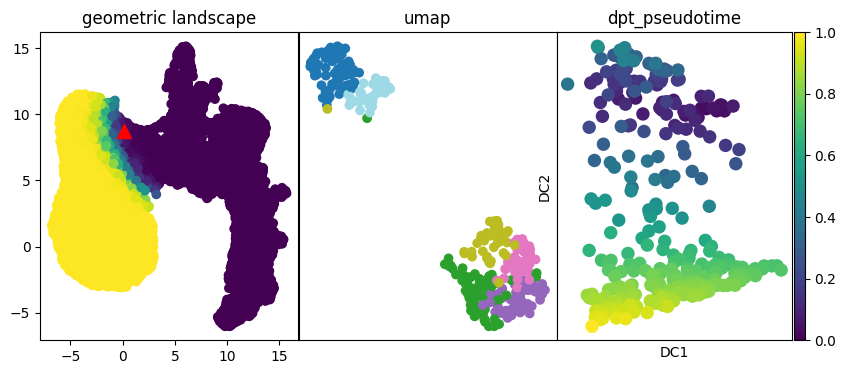

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\pancreatic-beta-cell-maturation_zhang.rds.csv


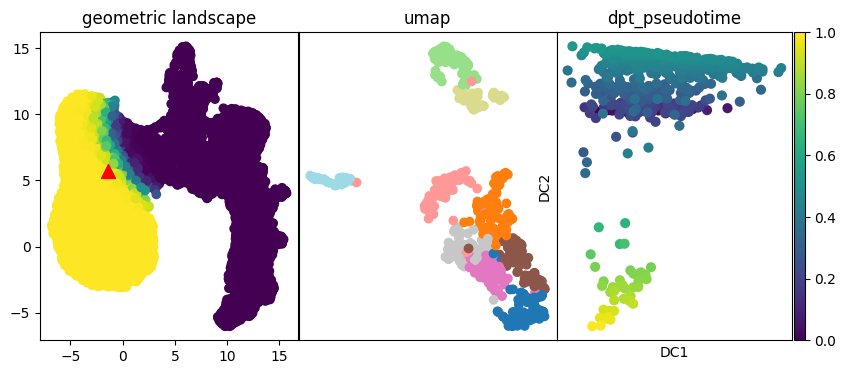

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\placenta-trophoblast-differentiation-invasive_mca.rds.csv


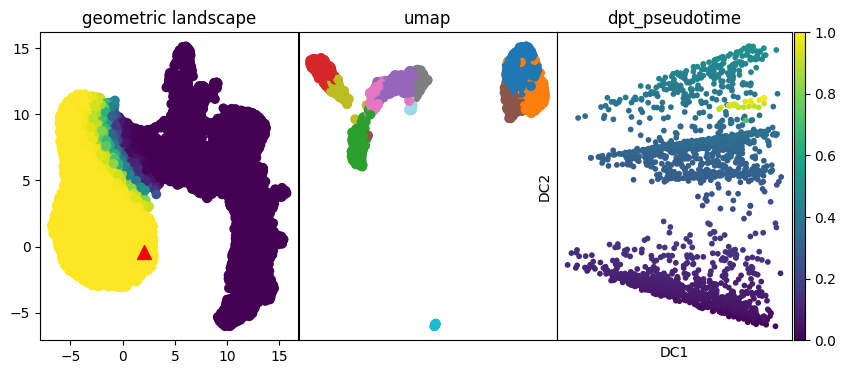

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\placenta-trophoblast-differentiation_mca.rds.csv


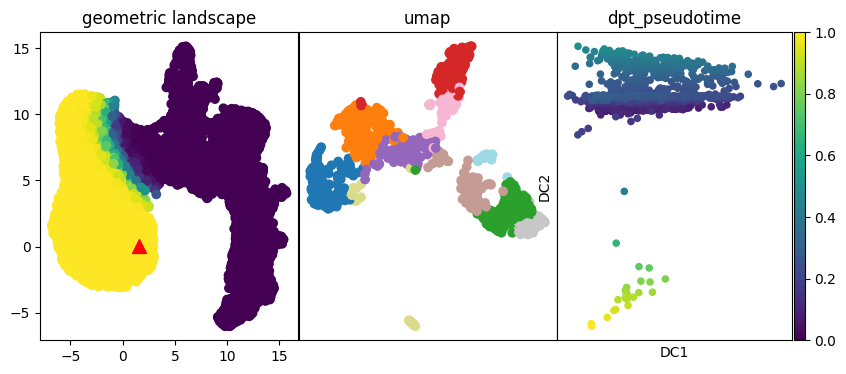

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-10_plass.rds.csv


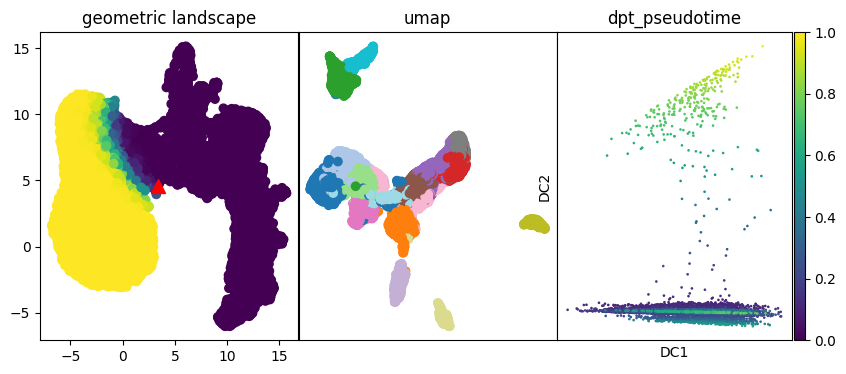

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-11_plass.rds.csv


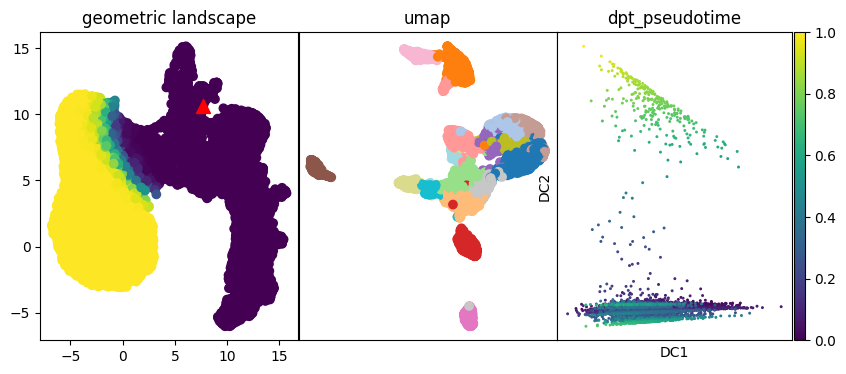

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-12_plass.rds.csv


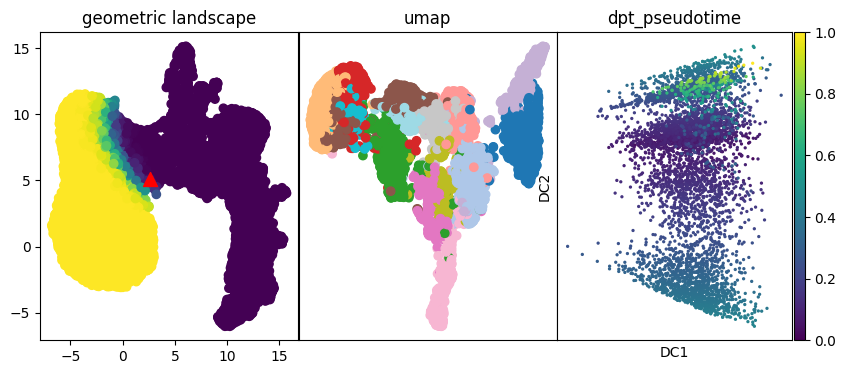

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-13_plass.rds.csv


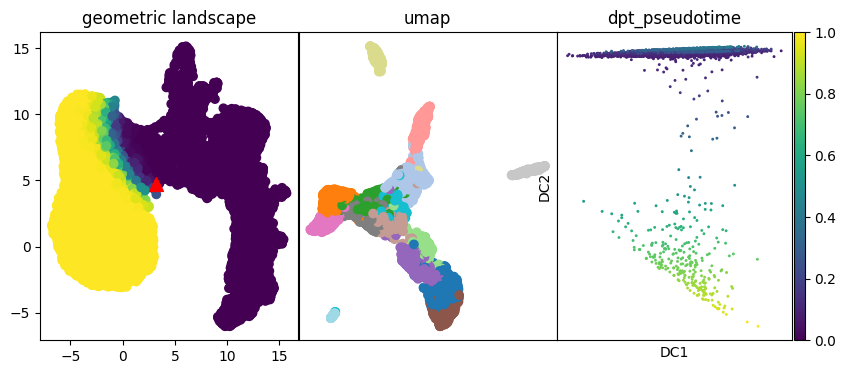

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-14_plass.rds.csv


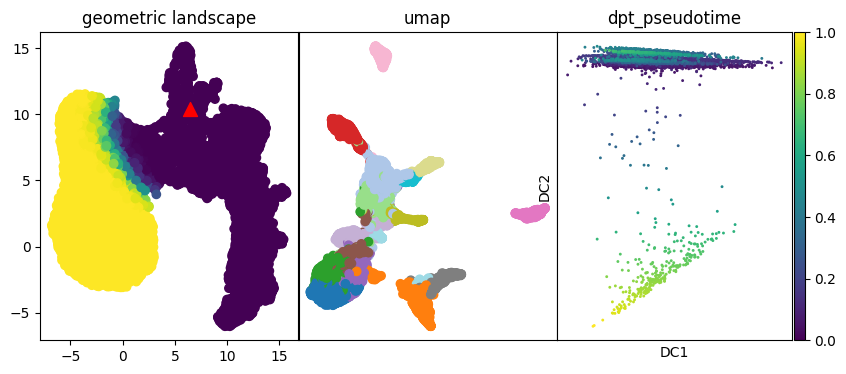

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-1_plass.rds.csv


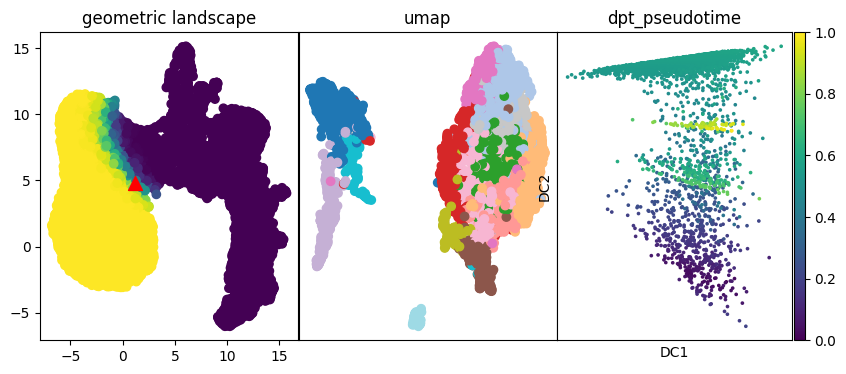

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-2_plass.rds.csv


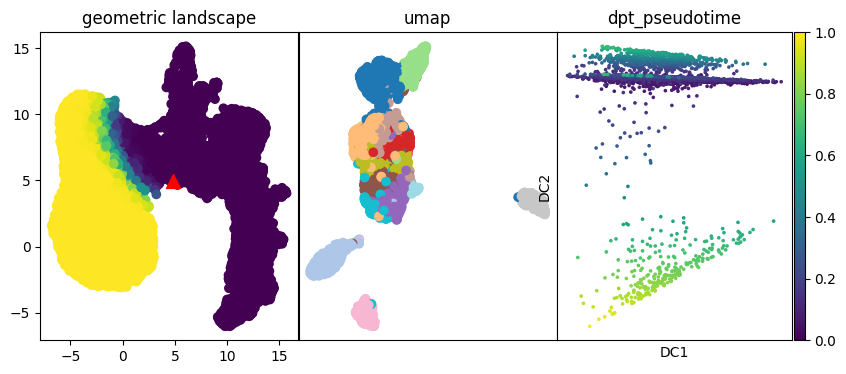

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-3_plass.rds.csv


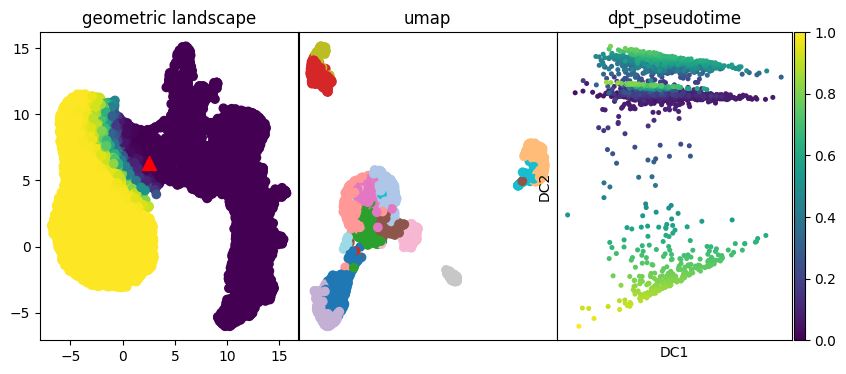

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-4_plass.rds.csv


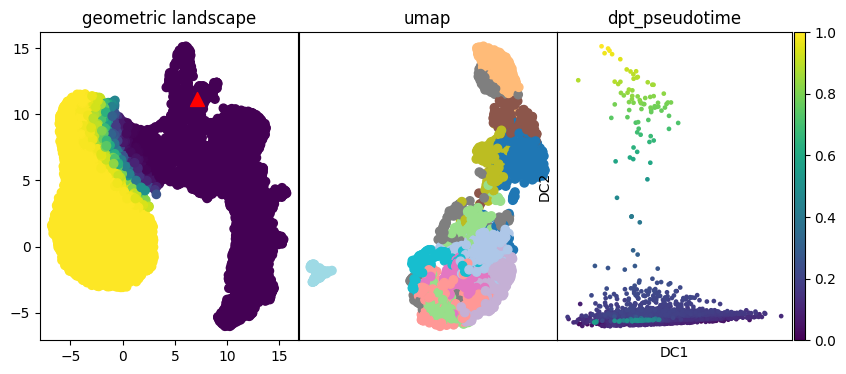

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-5_plass.rds.csv


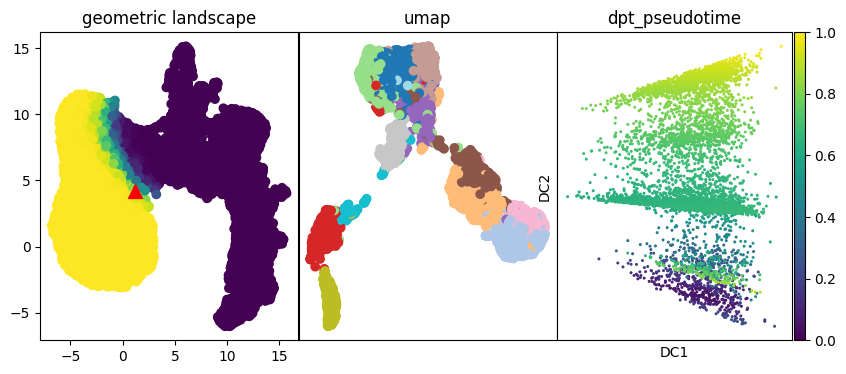

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-6_plass.rds.csv


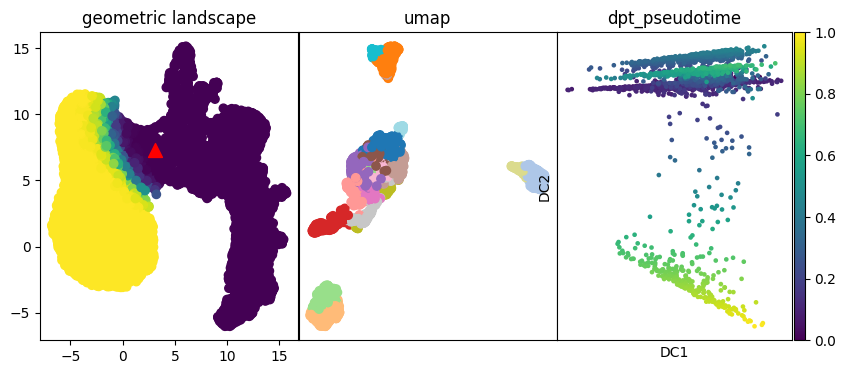

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-7_plass.rds.csv


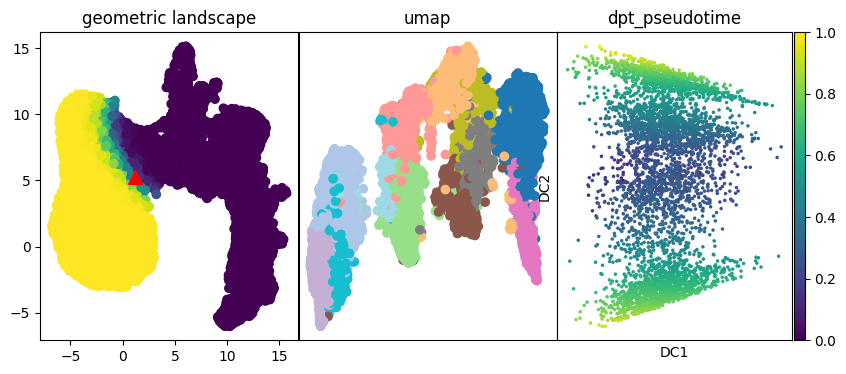

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-combination-9_plass.rds.csv


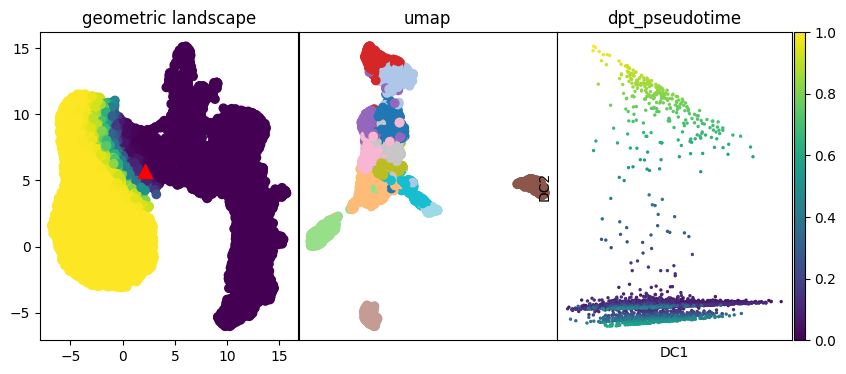

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-epidermis-differentiation_plass.rds.csv


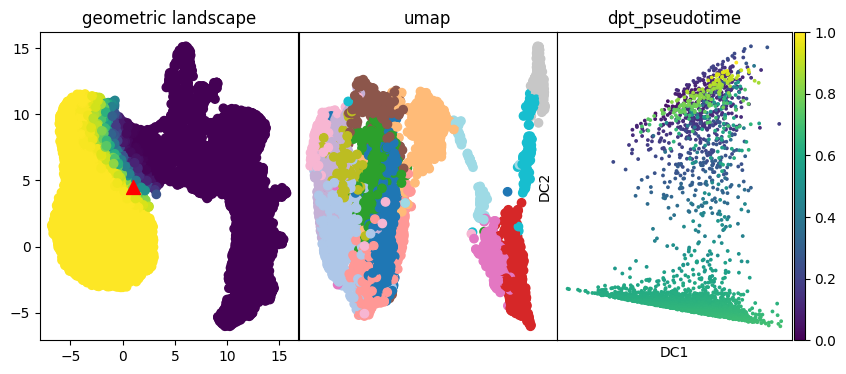

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-full_plass.rds.csv


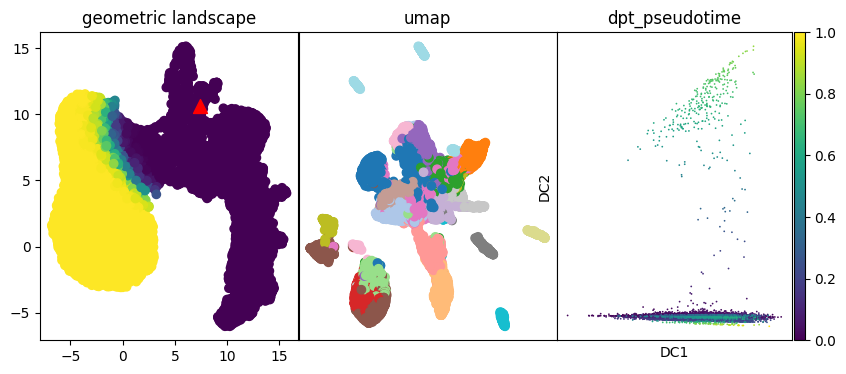

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-muscle-differentiation_plass.rds.csv


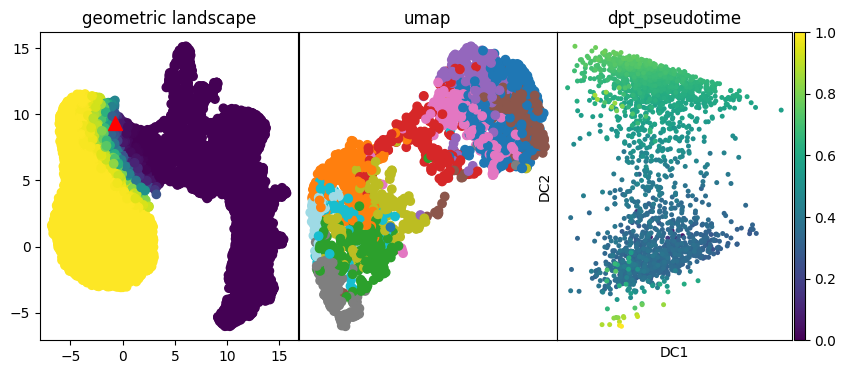

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-neuron-differentiation_plass.rds.csv


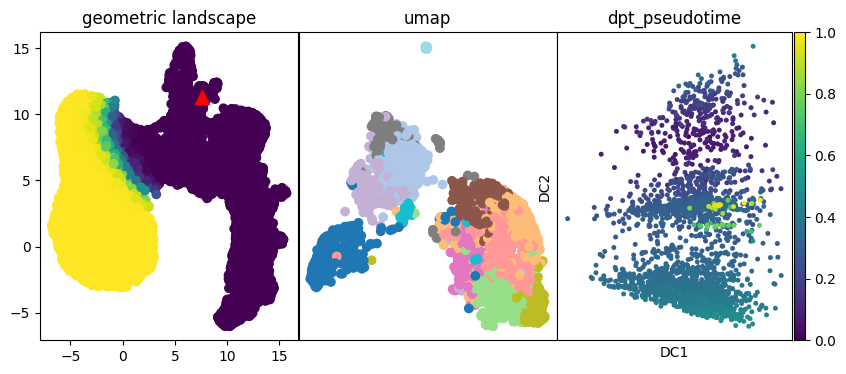

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-10_plass.rds.csv


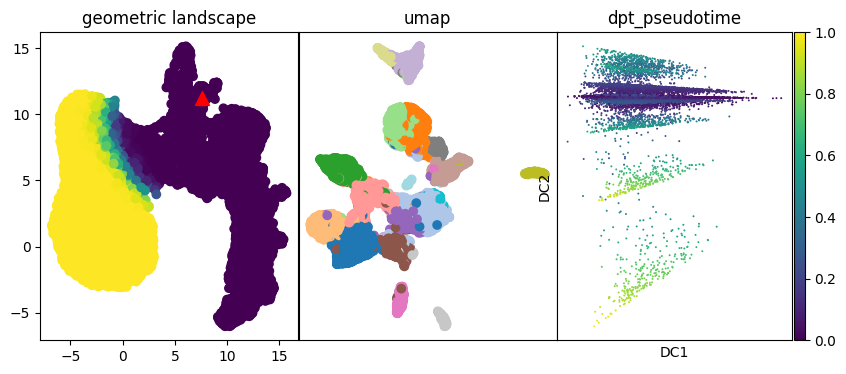

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-11_plass.rds.csv


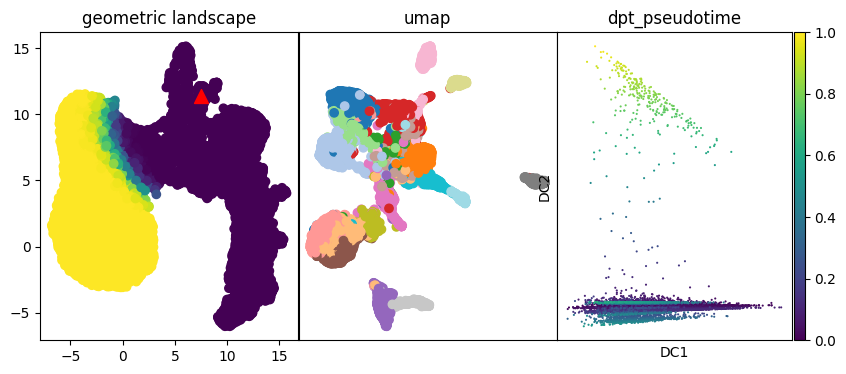

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-12_plass.rds.csv


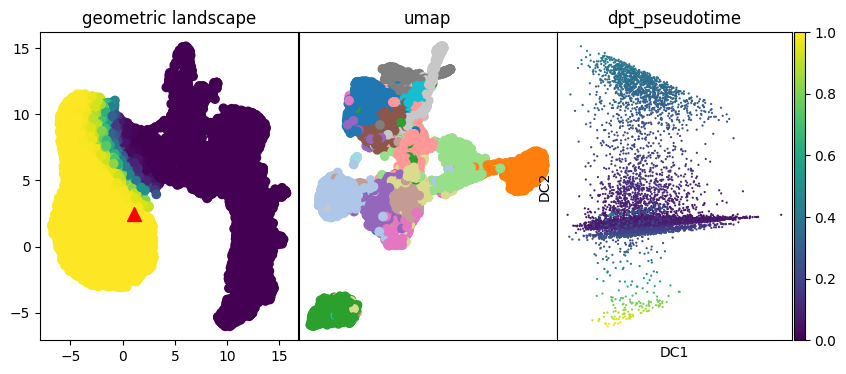

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-13_plass.rds.csv


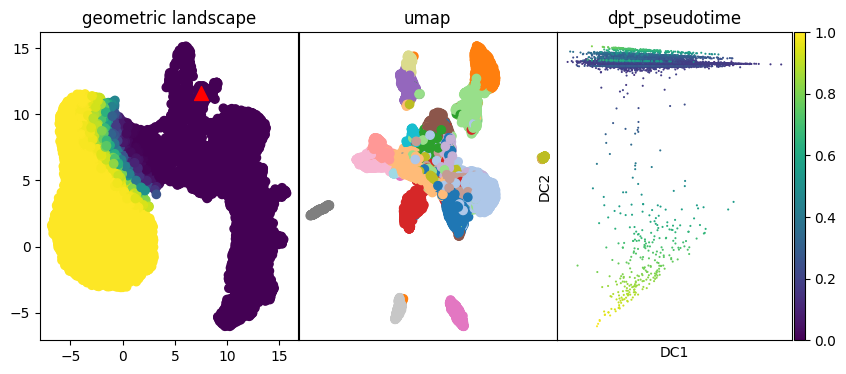

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-14_plass.rds.csv


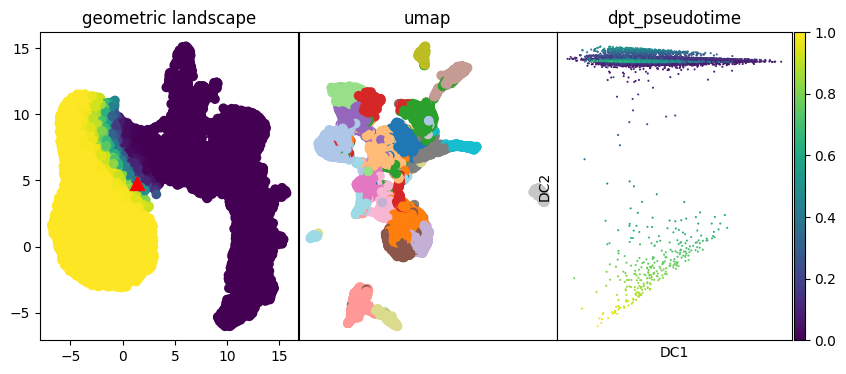

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-1_plass.rds.csv


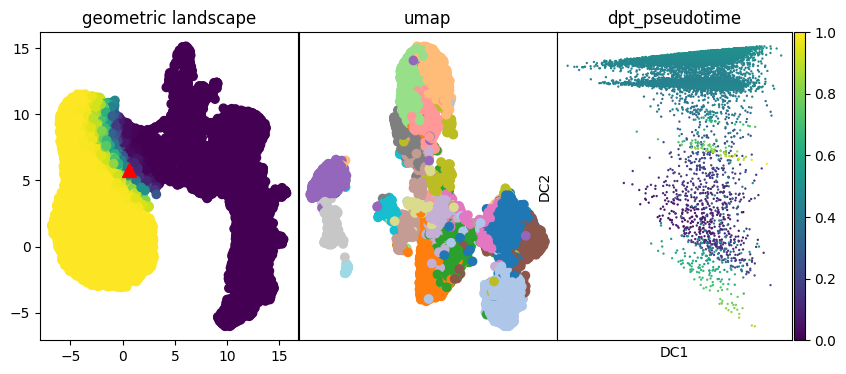

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-2_plass.rds.csv


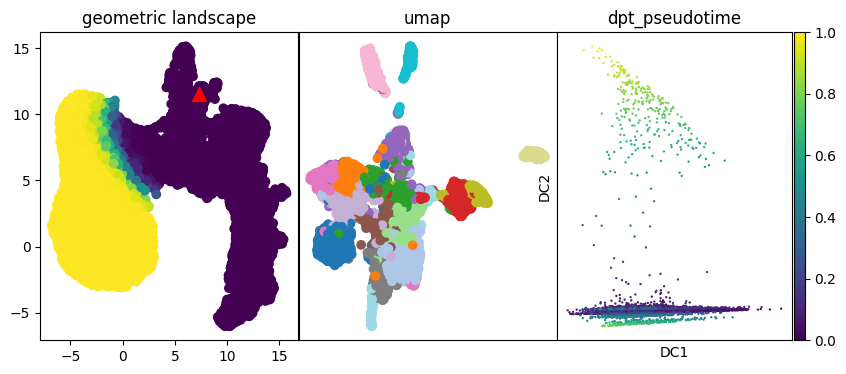

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-3_plass.rds.csv


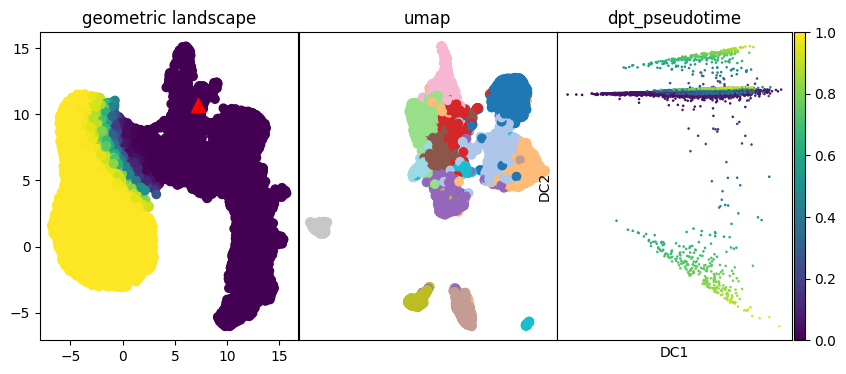

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-4_plass.rds.csv


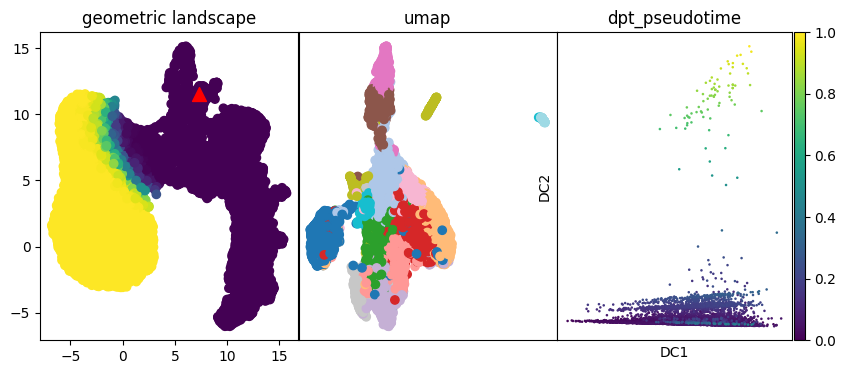

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-5_plass.rds.csv


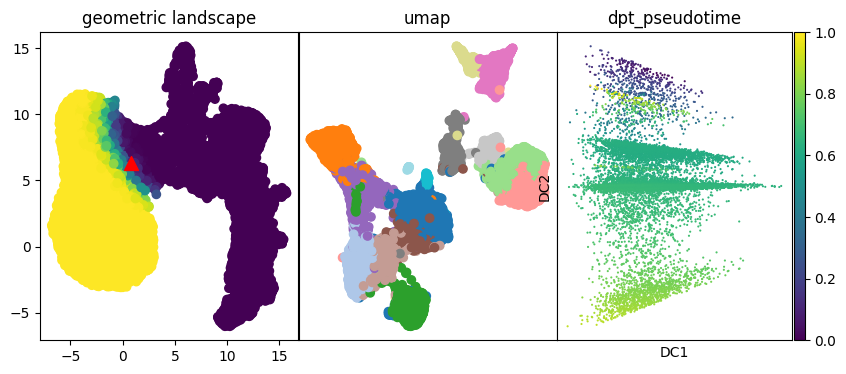

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-6_plass.rds.csv


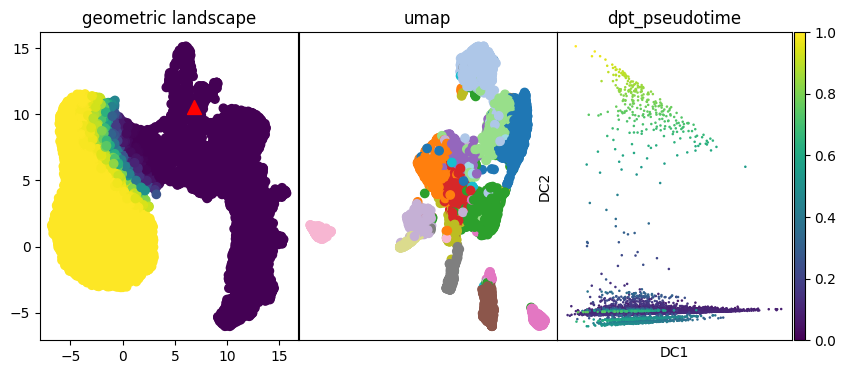

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-7_plass.rds.csv


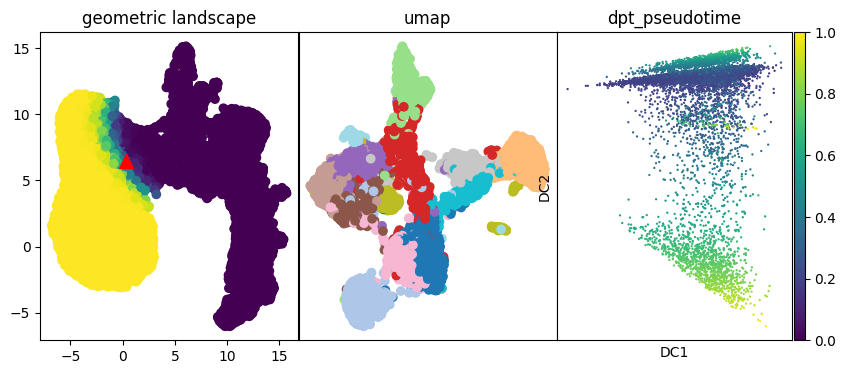

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-8_plass.rds.csv


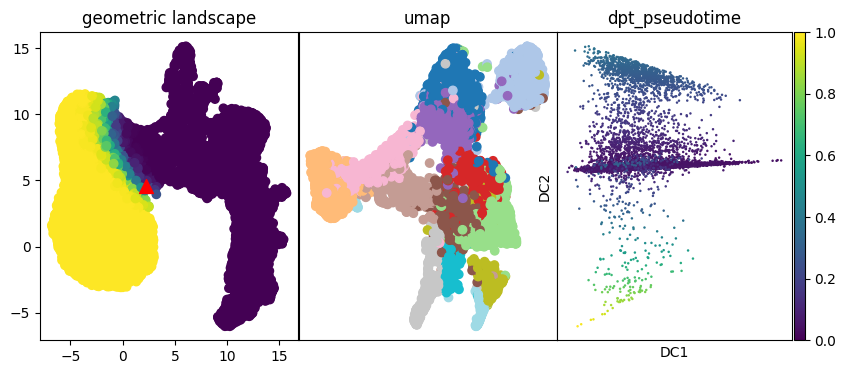

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pair-9_plass.rds.csv


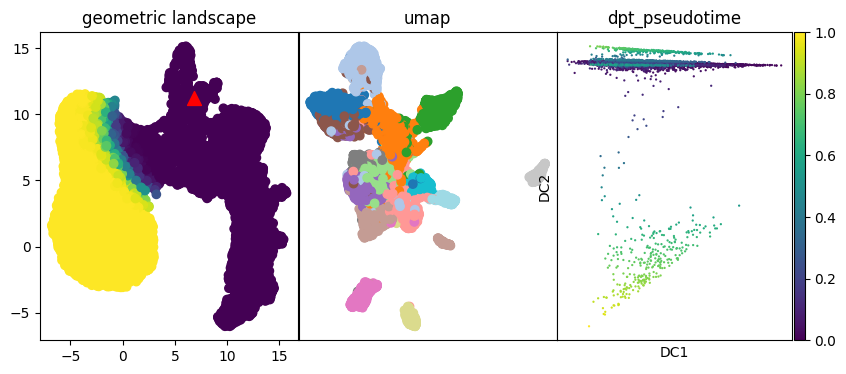

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-parenchyme-differentiation_plass.rds.csv


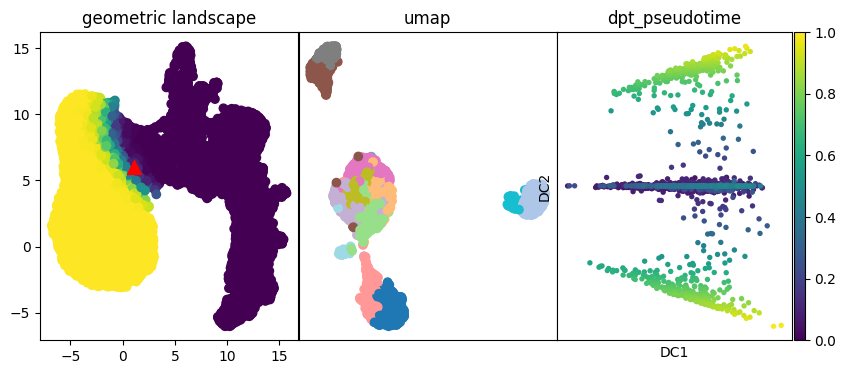

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-phagocyte-differentiation_plass.rds.csv


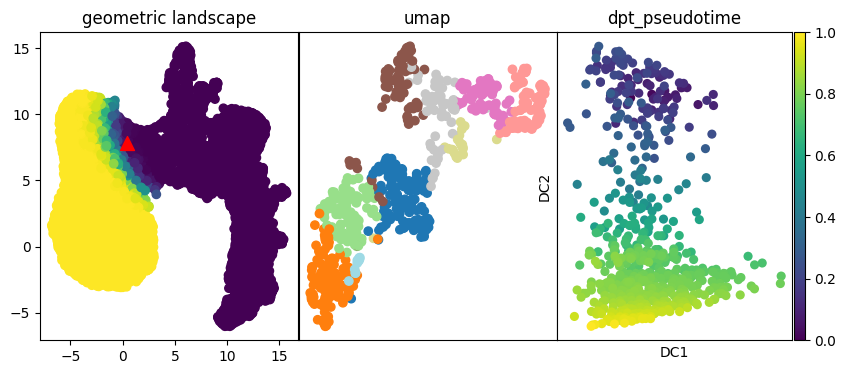

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\planaria-pharynx-differentiation_plass.rds.csv


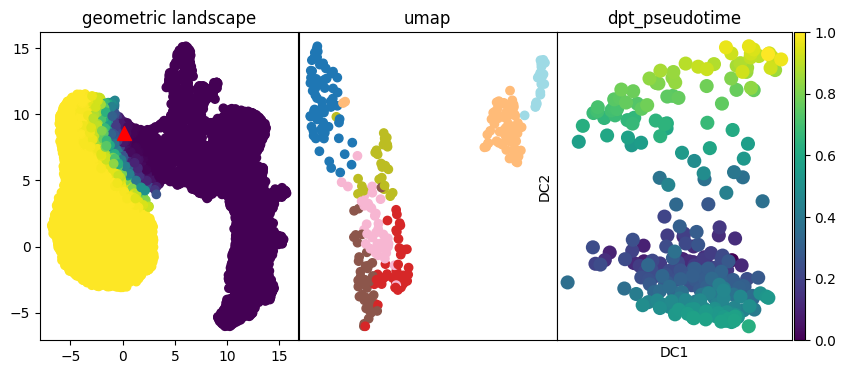

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\psc-astrocyte-maturation-glia_sloan.rds.csv


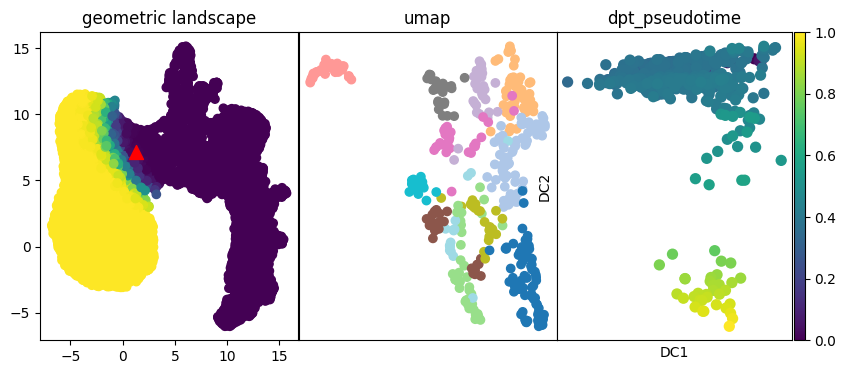

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\psc-astrocyte-maturation-neuron_sloan.rds.csv


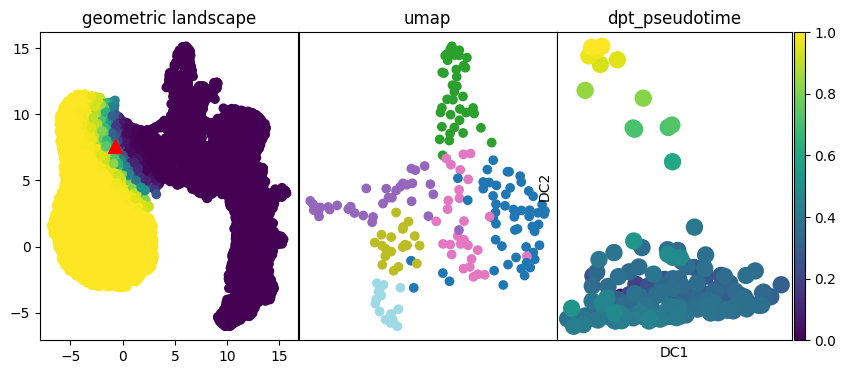

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\stimulated-dendritic-cells-LPS_shalek.rds.csv


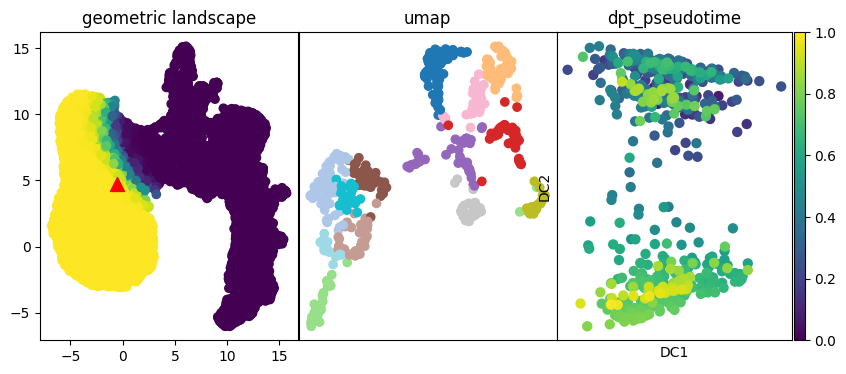

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\stimulated-dendritic-cells-PAM_shalek.rds.csv


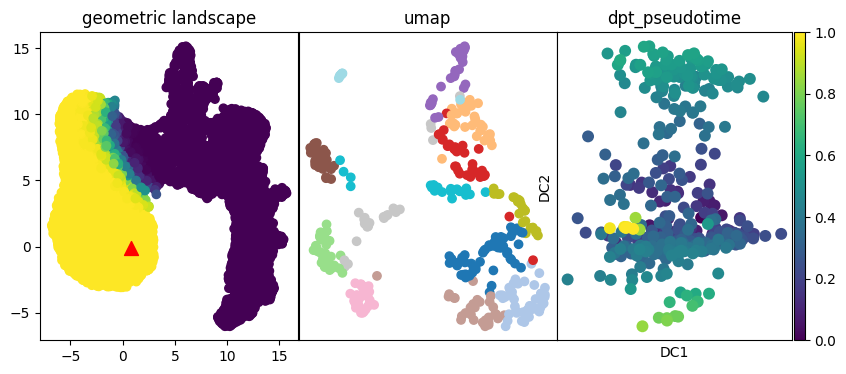

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\stimulated-dendritic-cells-PIC_shalek.rds.csv


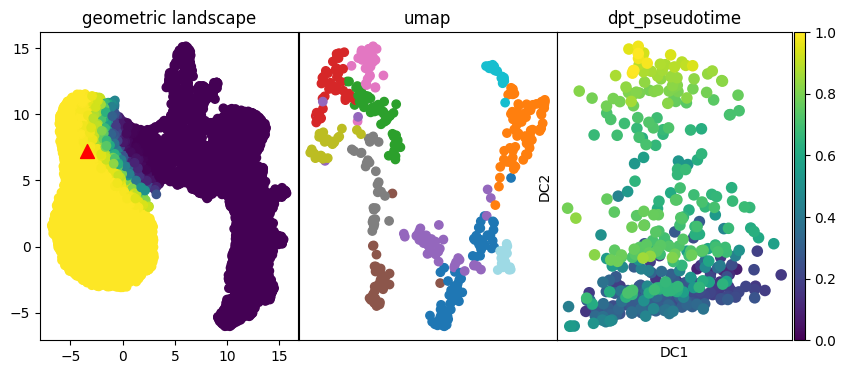

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\thymus-t-cell-differentiation_mca.rds.csv


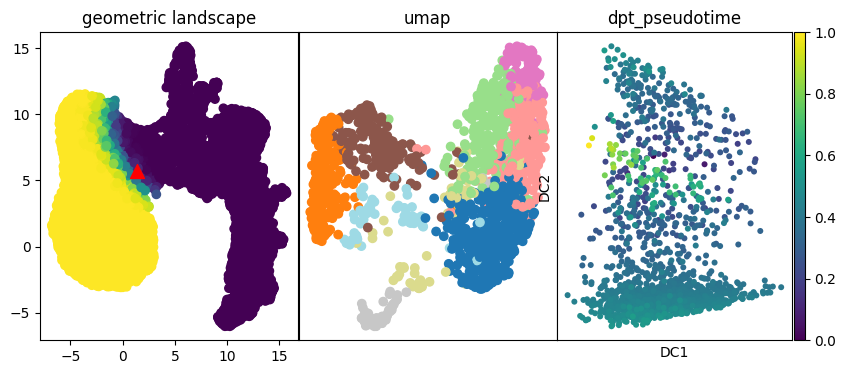

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\trophectoderm-monkey_nakamura.rds.csv


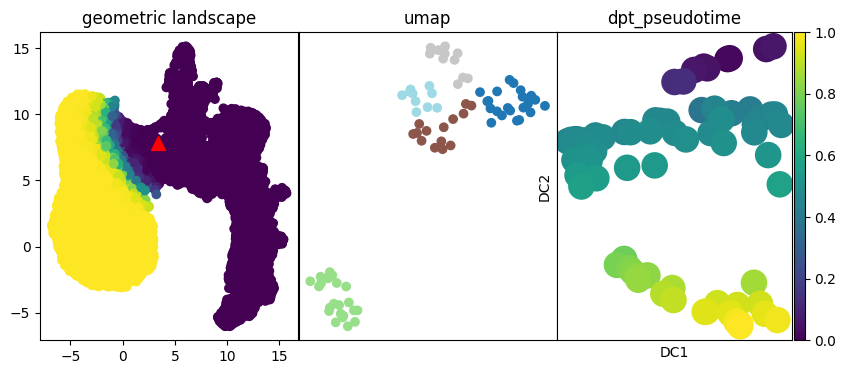

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=
data/benchmarkfiles\trophoblast-stem-cell-trophoblast-differentiation_mca.rds.csv


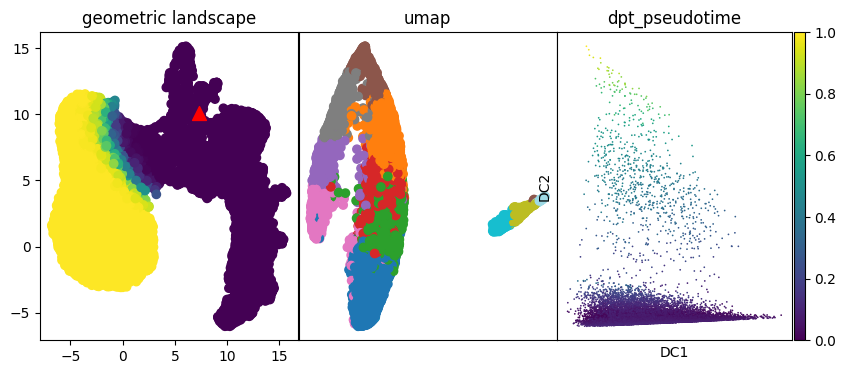

--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=


In [4]:
files = glob.glob("data/benchmarkfiles/*.csv") 
for i in range(len(files)):
        try:
                fig, axs = plt.subplots(1,3, figsize=(10, 4), facecolor='w', edgecolor='k')
                fig.subplots_adjust(hspace = .5, wspace=.001)
                axs = axs.ravel()

                print(files[i])
                df = pd.read_csv(files[i], index_col=0)
                df = preprocessing(np.array(df))
                data = np.array(df)
                data = AnnData(data)
                data.uns['iroot'] = 0 

                pca = PCA(n_components=20)
                embedding_pca = pca.fit_transform(df)
                A = kneighbors_graph(embedding_pca, 10, mode='connectivity', include_self=True)
                louvain = Louvain()
                labels = louvain.fit_transform(A)
                Umap = umap.UMAP()
                embedding_umap = Umap.fit_transform(embedding_pca)
                #fig = plt.figure(figsize=(5,5))
                axs[1].scatter(embedding_umap[:,0],embedding_umap[:,1],c=labels, alpha=1, cmap='tab20')
                axs[1].set_xticks([])
                axs[1].set_yticks([])
                axs[1].set_title('umap')

                proj = coordinates[files[i].split('\\')[-1].split('.rds')[0]]
                axs[0].scatter(embedding[:,0],embedding[:,1], c = p, alpha = 1)
                axs[0].scatter(proj[0],proj[1], c = 'r', s = 100,  marker="^")
                axs[0].set_title('geometric landscape')

                #sp.set_figure_params(dpi=80, dpi_save=150, figsize=(5,5))
                sp.tl.pca(data, svd_solver='arpack')
                sp.pp.neighbors(data)
                sp.tl.diffmap(data)
                sp.tl.dpt(data)
                sp.pl.diffmap(data,color=['dpt_pseudotime'],ax=axs[2])    
                print('--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=-=-=-=--=')
        except:
                print('error occured for {}'.format(files[i]))

data/scHuman\filtered_TS_Bladder.csv


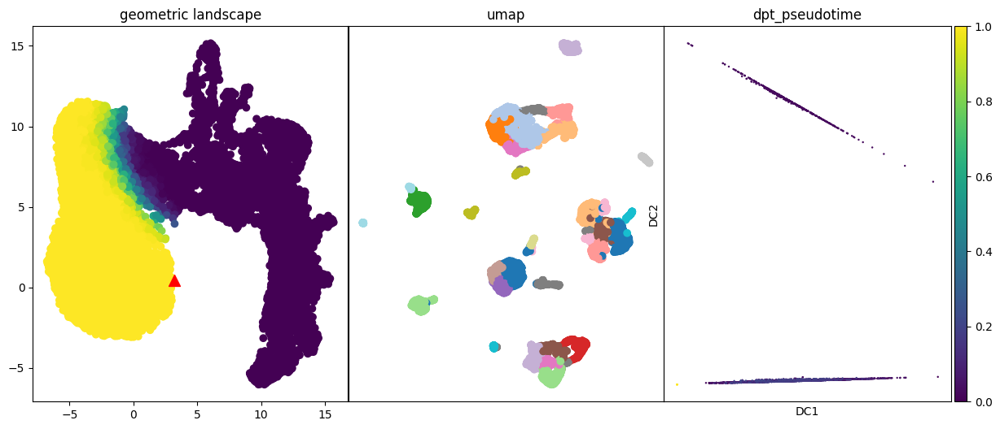

data/scHuman\filtered_TS_Blood.csv


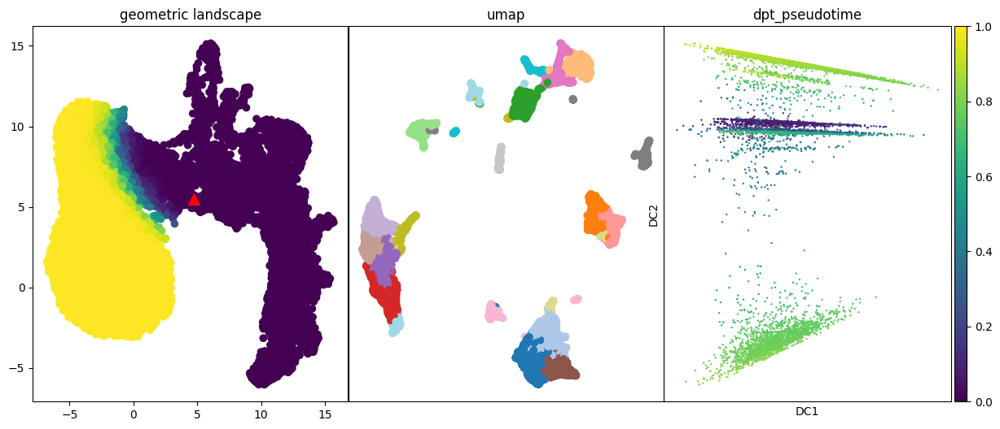

data/scHuman\filtered_TS_Bone_Marrow.csv


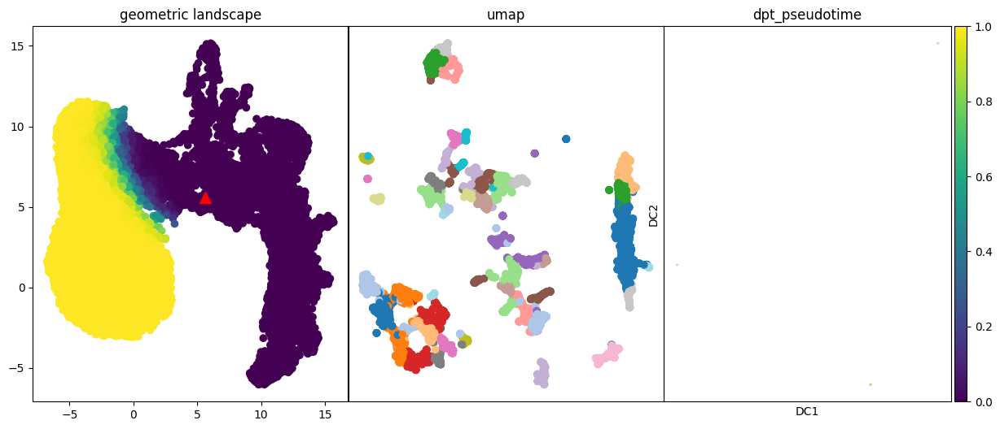

data/scHuman\filtered_TS_endothelial.csv


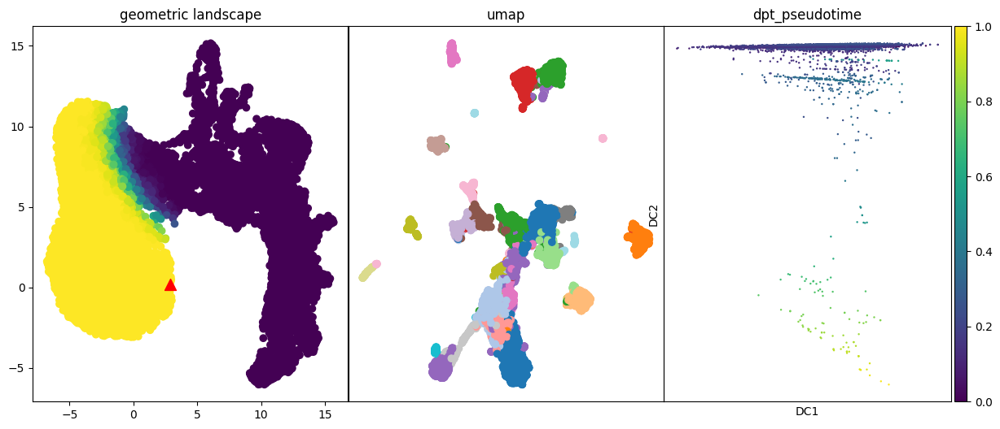

data/scHuman\filtered_TS_epithelial.csv


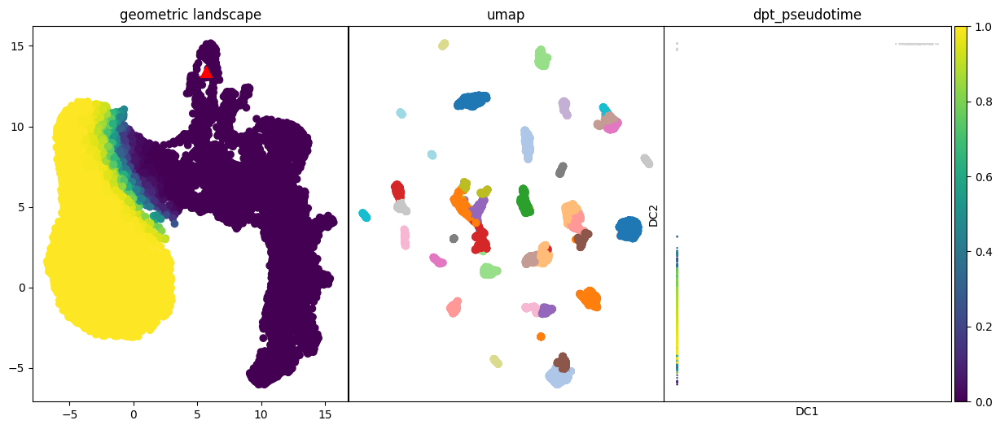

data/scHuman\filtered_TS_Eye.csv


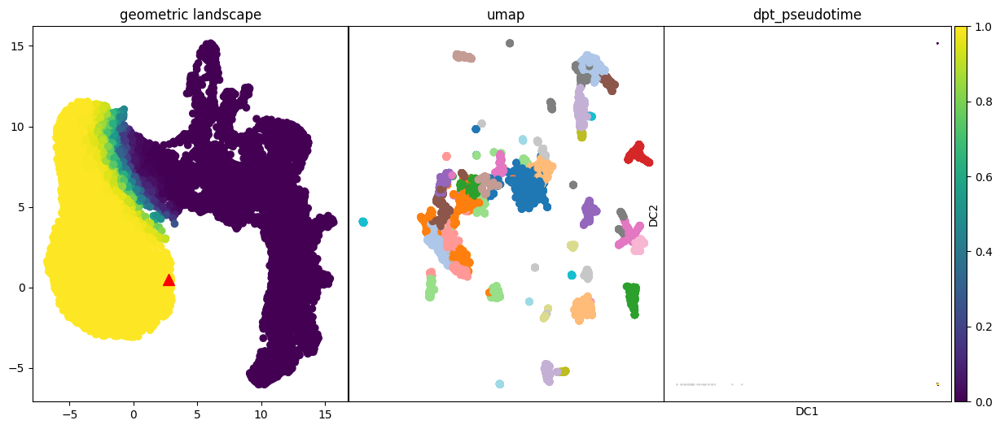

data/scHuman\filtered_TS_Fat.csv


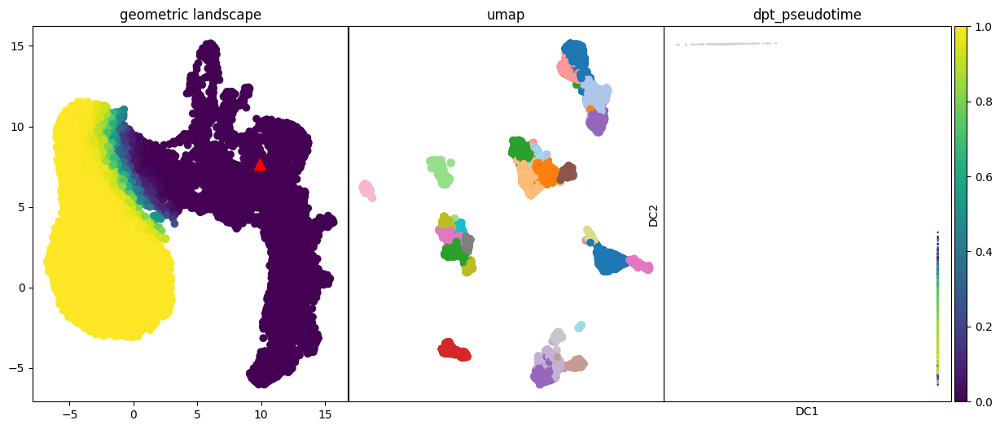

error occured for data/scHuman\filtered_TS_germ line.csv
data/scHuman\filtered_TS_Heart.csv


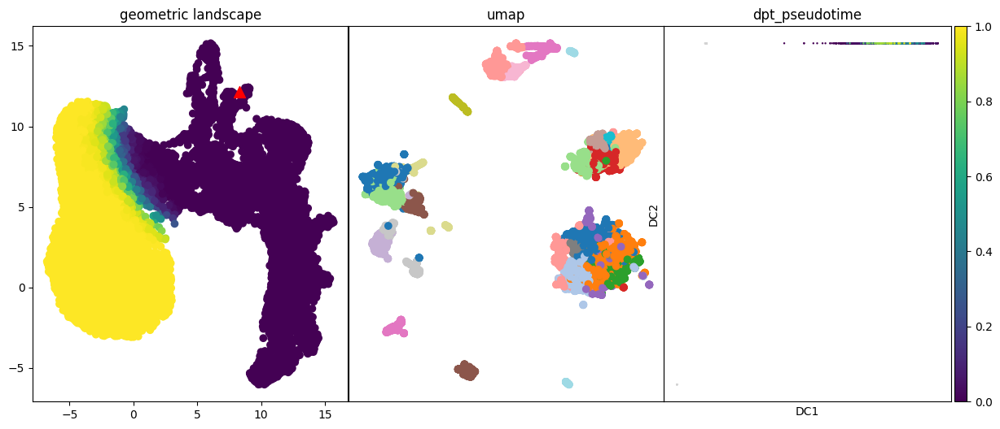

data/scHuman\filtered_TS_immune.csv


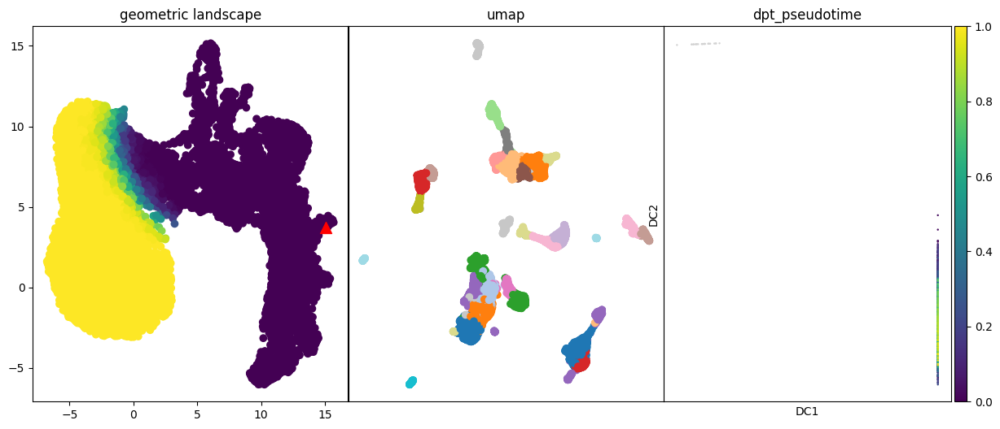

data/scHuman\filtered_TS_Kidney.csv


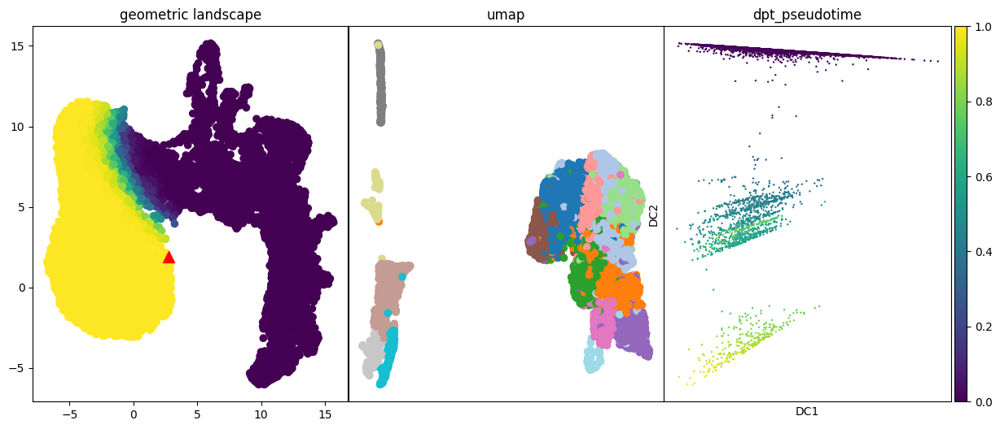

data/scHuman\filtered_TS_Large_Intestine.csv


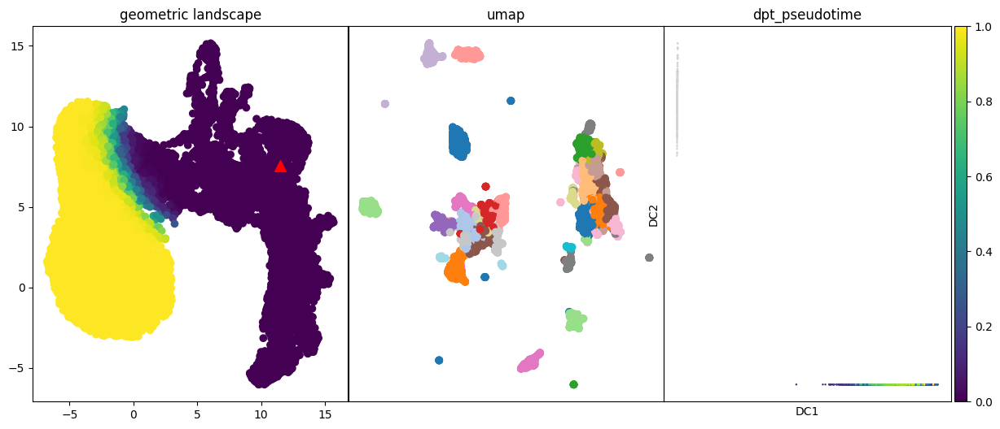

data/scHuman\filtered_TS_Liver.csv


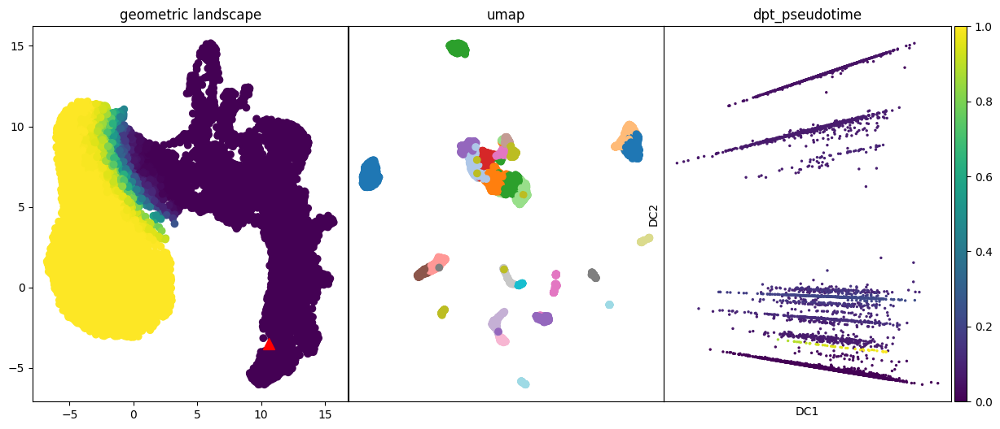

data/scHuman\filtered_TS_Lung.csv


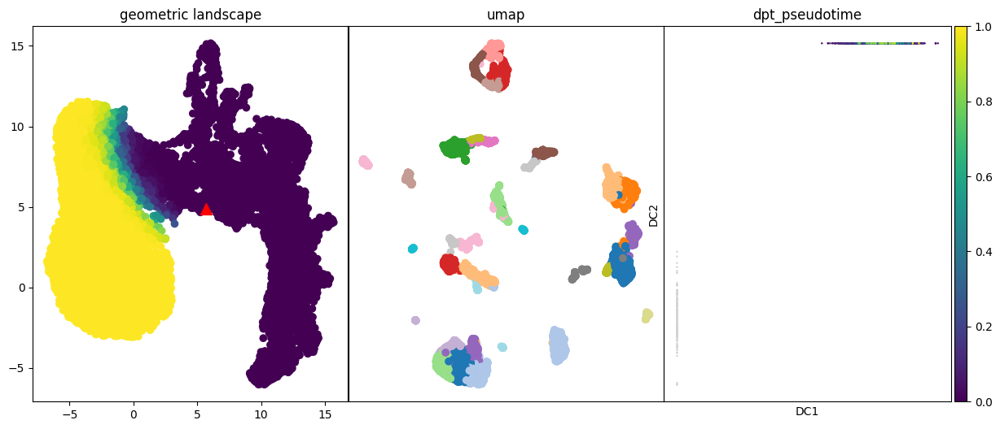

data/scHuman\filtered_TS_Lymph_Node.csv


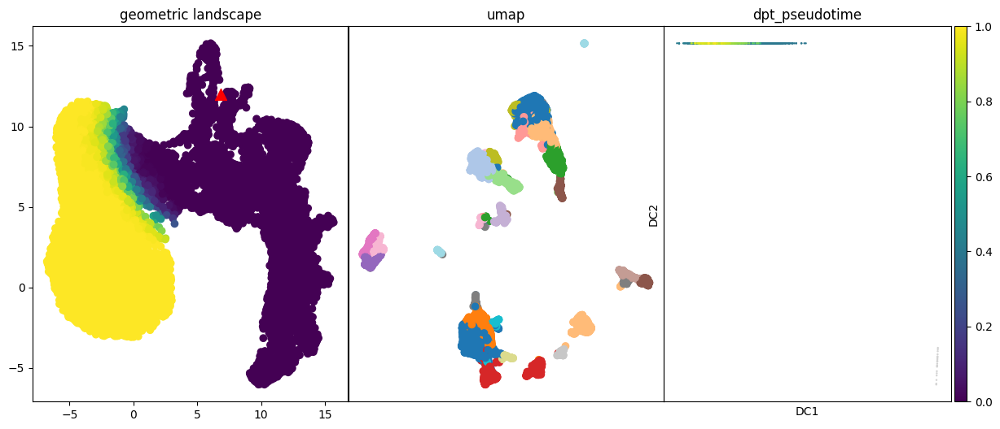

data/scHuman\filtered_TS_Mammary.csv


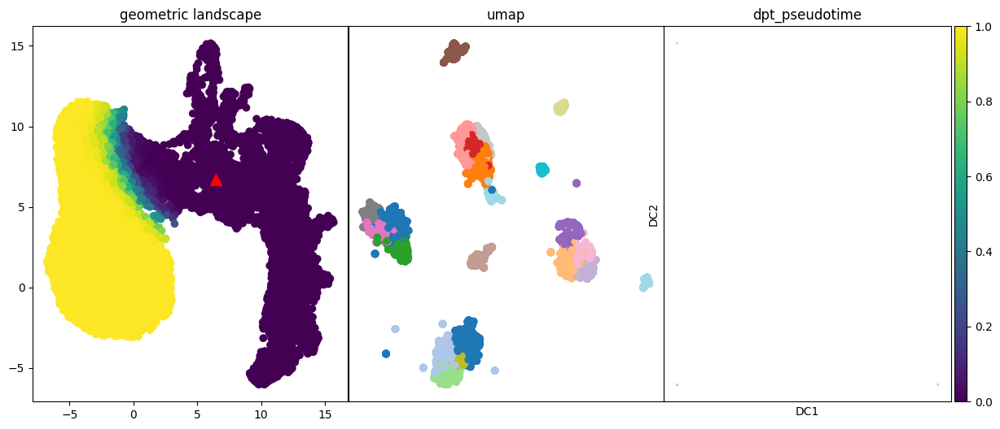

data/scHuman\filtered_TS_Muscle.csv


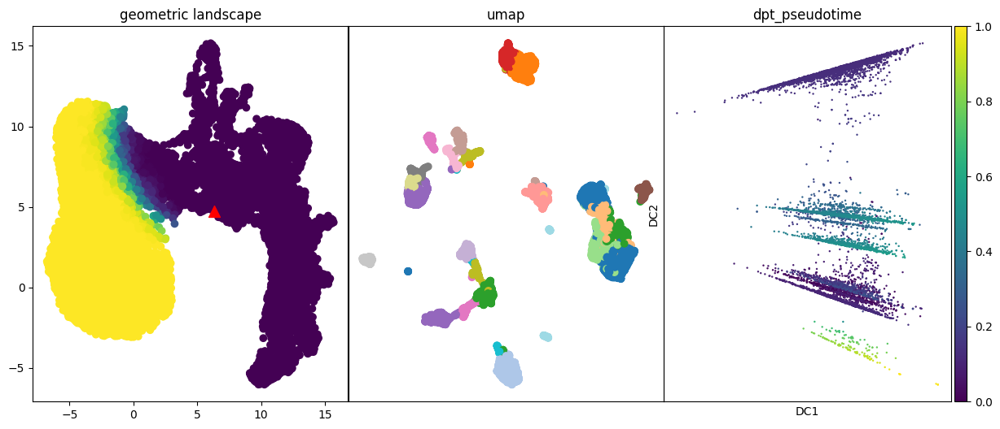

data/scHuman\filtered_TS_Pancreas.csv


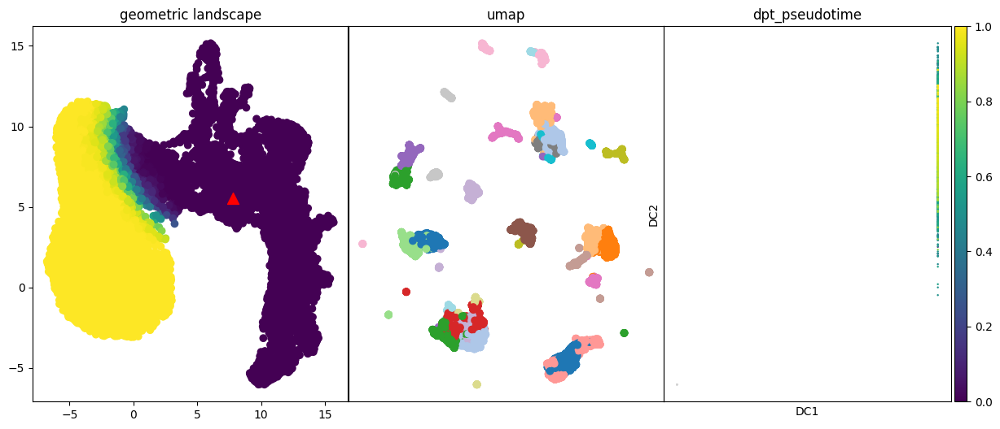

data/scHuman\filtered_TS_Prostate.csv


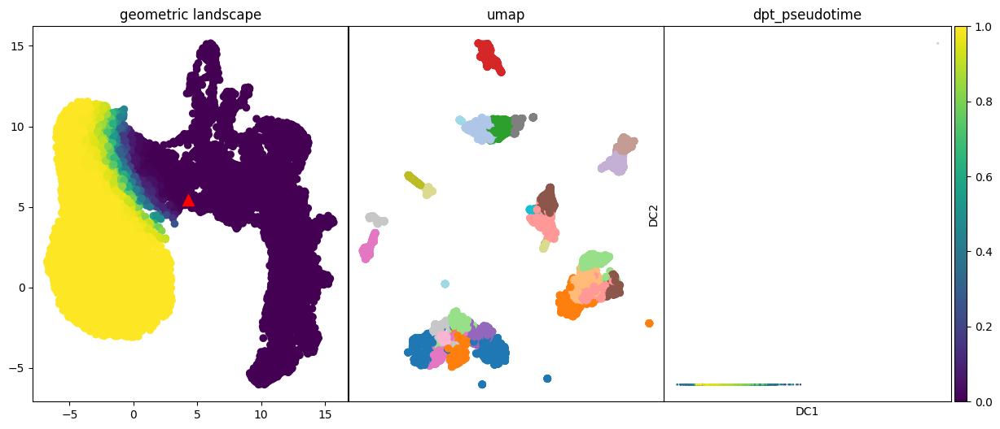

data/scHuman\filtered_TS_Salivary_Gland.csv


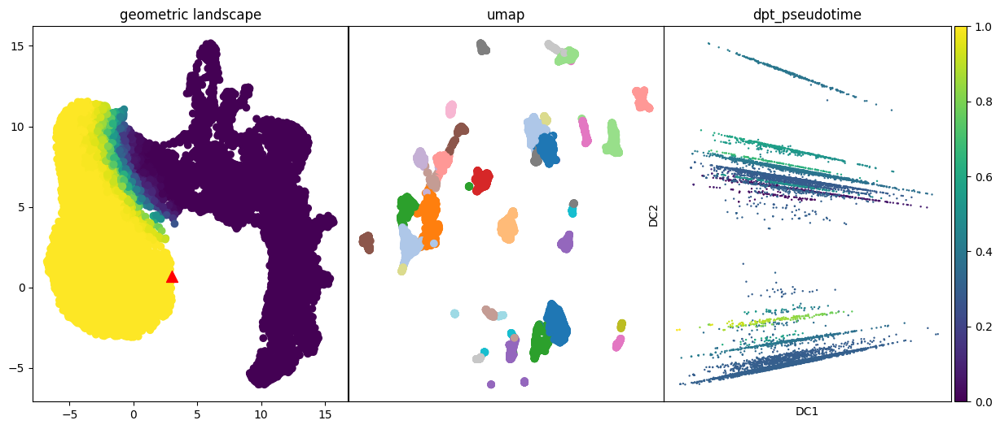

data/scHuman\filtered_TS_Skin.csv


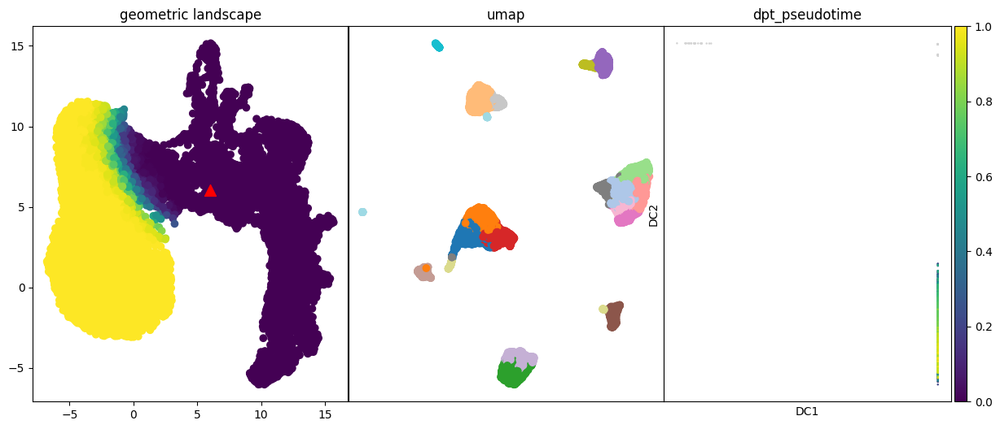

data/scHuman\filtered_TS_Small_Intestine.csv


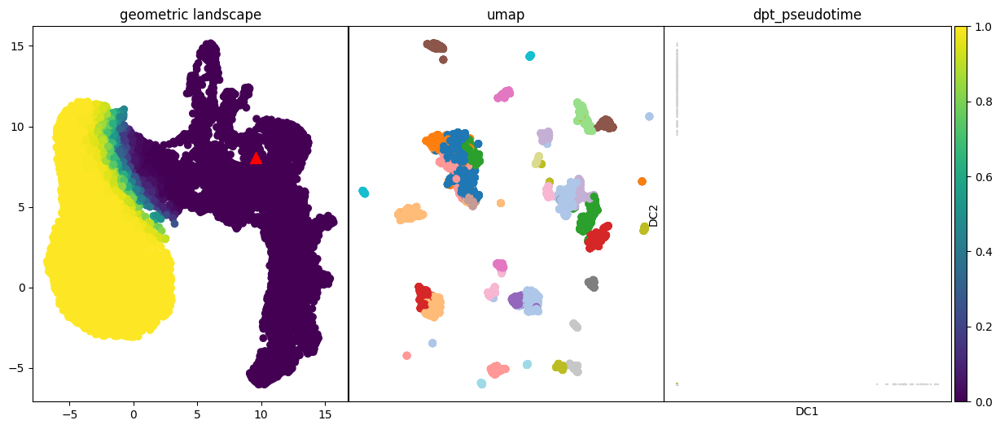

data/scHuman\filtered_TS_Spleen.csv


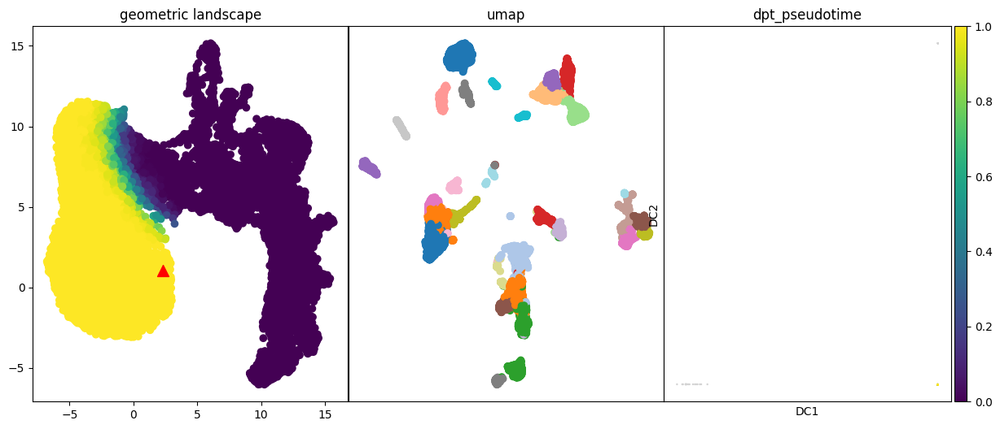

data/scHuman\filtered_TS_stromal.csv


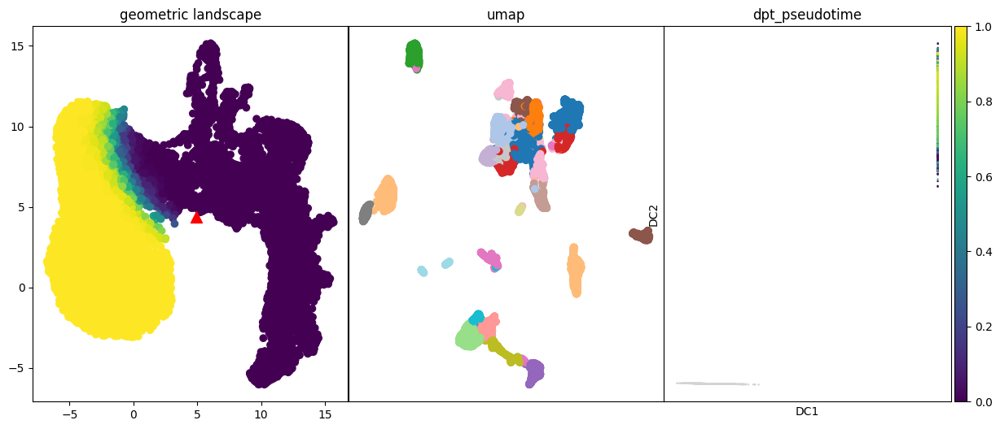

data/scHuman\filtered_TS_Thymus.csv


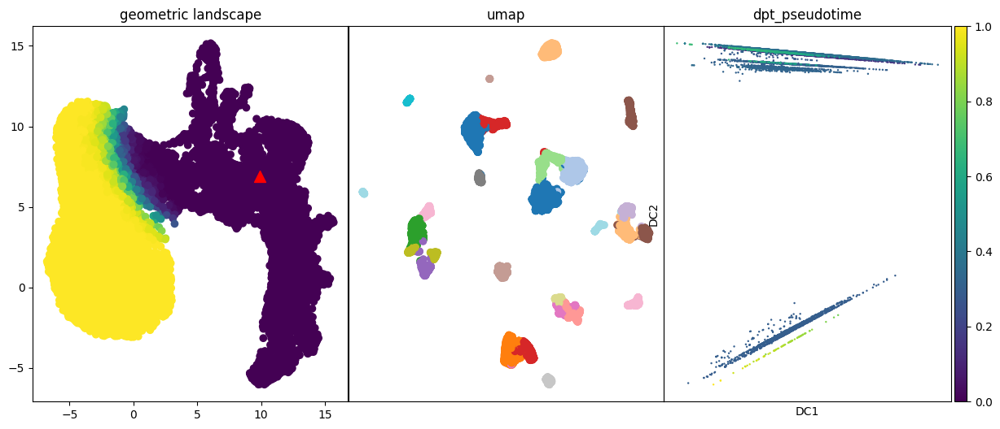

data/scHuman\filtered_TS_Tongue.csv


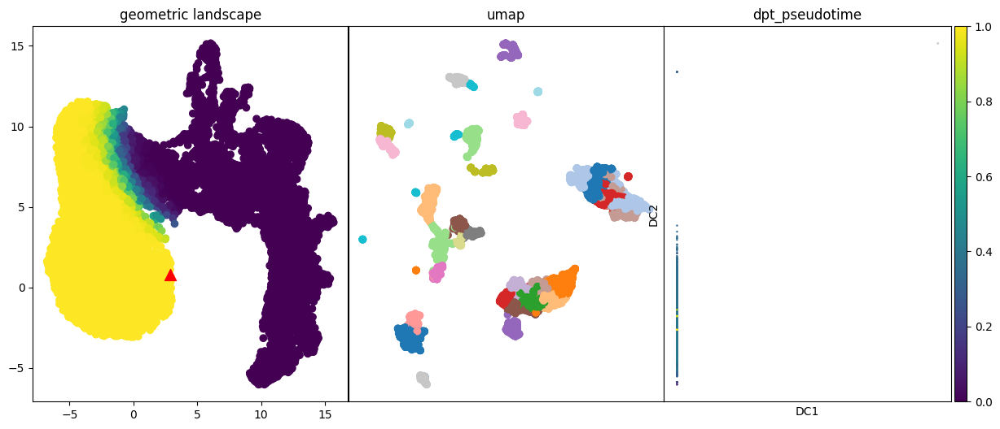

data/scHuman\filtered_TS_Trachea.csv


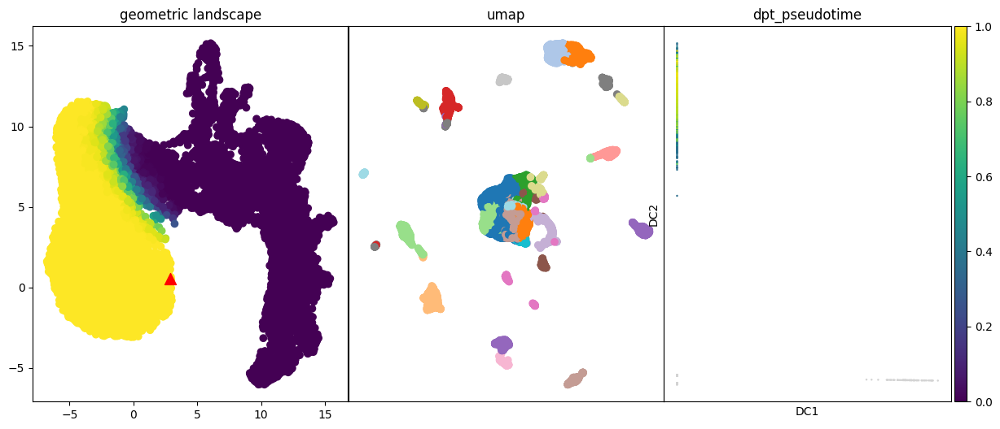

data/scHuman\filtered_TS_Uterus.csv


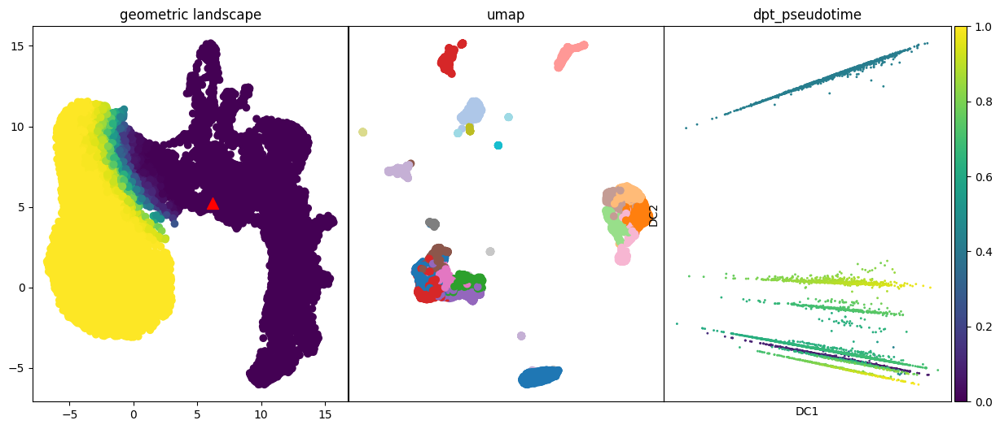

data/scHuman\filtered_TS_Vasculature.csv


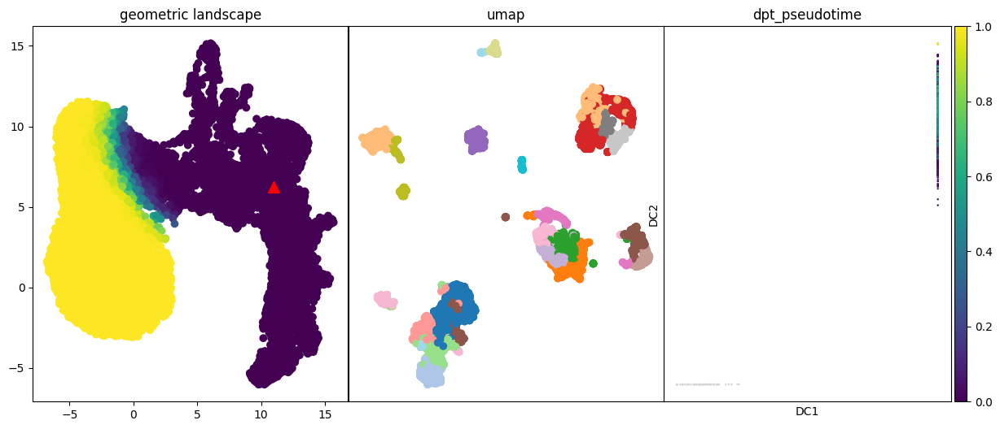

In [5]:
for file in glob.glob("data/scHuman/*.csv"):
    try:
        
        proj = coordinates[file.split('filtered_TS_')[-1].split('.csv')[0]]
        fig, axs = plt.subplots(1,3, figsize=(15, 6), facecolor='w', edgecolor='k')
        fig.subplots_adjust(hspace = .5, wspace=.001)
        axs = axs.ravel()

        print(file)
        df = pd.read_csv(file, index_col=0)
        #df = preprocessing(np.array(df))
        data = np.array(df)
        data = AnnData(data)
        data.uns['iroot'] = 0 

        pca = PCA(n_components=20)
        embedding_pca = pca.fit_transform(df)
        A = kneighbors_graph(embedding_pca, 10, mode='connectivity', include_self=True)
        louvain = Louvain()
        labels = louvain.fit_transform(A)
        Umap = umap.UMAP()
        embedding_umap = Umap.fit_transform(embedding_pca)
        #fig = plt.figure(figsize=(5,5))
        axs[1].scatter(embedding_umap[:,0],embedding_umap[:,1],c=labels, alpha=1, cmap='tab20')
        axs[1].set_xticks([])
        axs[1].set_yticks([])
        axs[1].set_title('umap')

        axs[0].scatter(embedding[:,0],embedding[:,1], c = p, alpha = 1)
        axs[0].scatter(proj[0],proj[1], c = 'r', s = 100,  marker="^")
        axs[0].set_title('geometric landscape')

        #sp.set_figure_params(dpi=80, dpi_save=150, figsize=(5,5))
        sp.tl.pca(data, svd_solver='arpack')
        sp.pp.neighbors(data)
        sp.tl.diffmap(data)
        sp.tl.dpt(data)
        sp.pl.diffmap(data,color=['dpt_pseudotime'],ax=axs[2])  
    except:
        print('error occured for {}'.format(file))
        continue 

data/datacuration\Broad-Habib-Human.csv


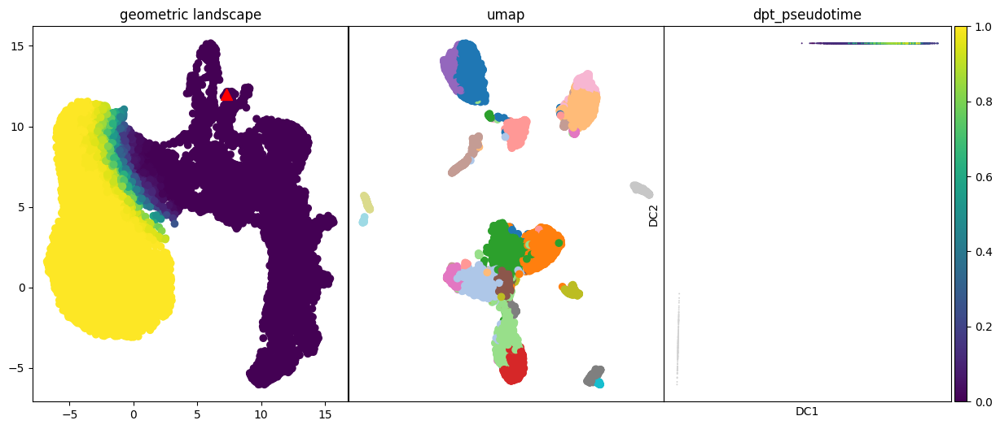

data/datacuration\Broad-Habib-Mouse.csv


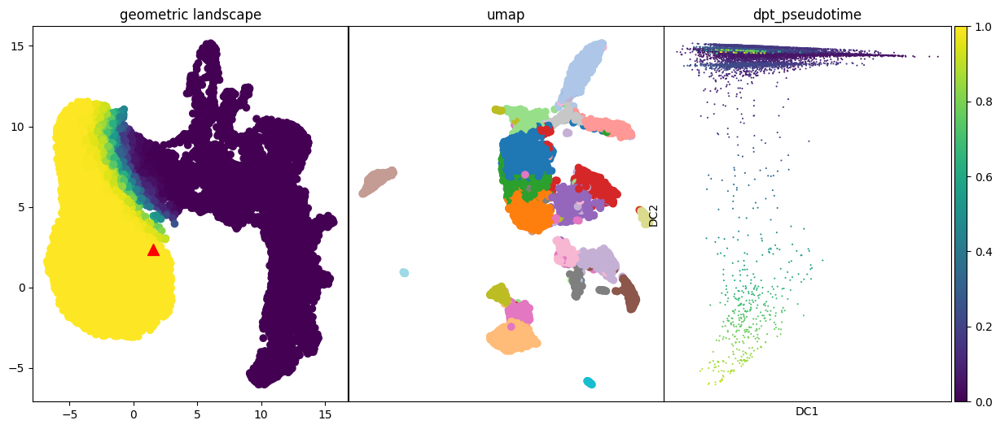

data/datacuration\EMTAB3321.csv


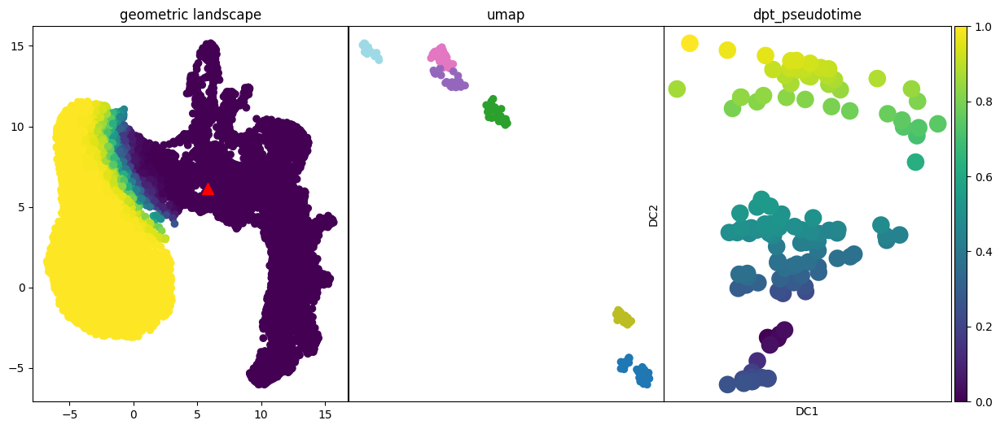

data/datacuration\EMTAB3929.csv


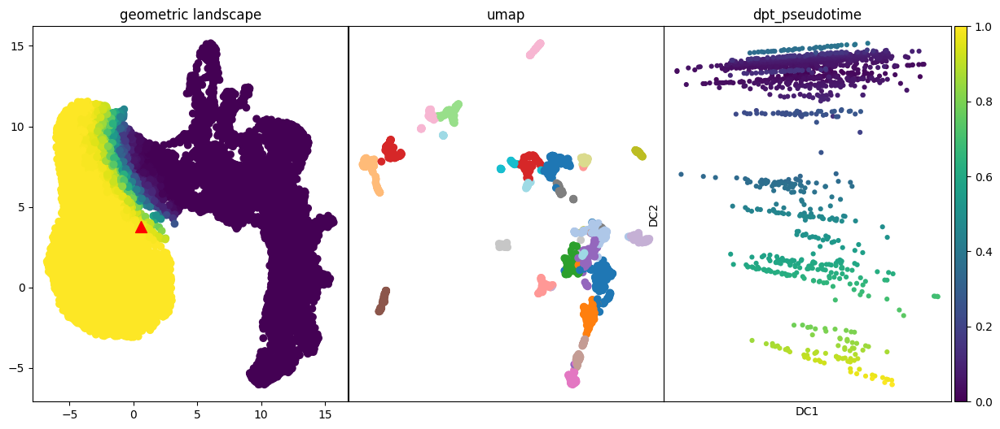

data/datacuration\GSE45719.csv


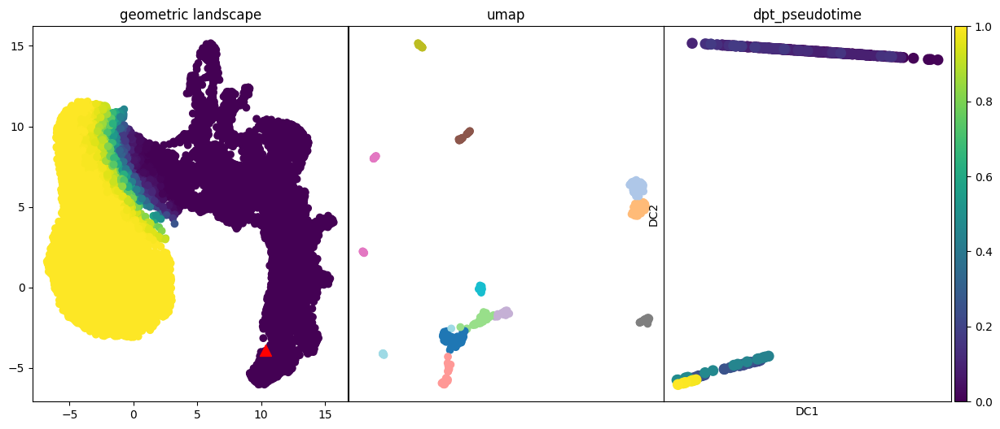

data/datacuration\GSE52583.csv


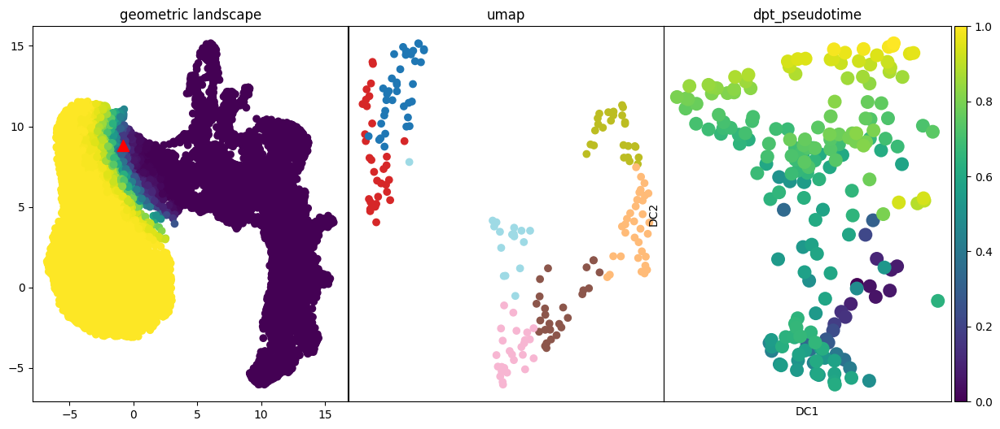

data/datacuration\GSE57249.csv


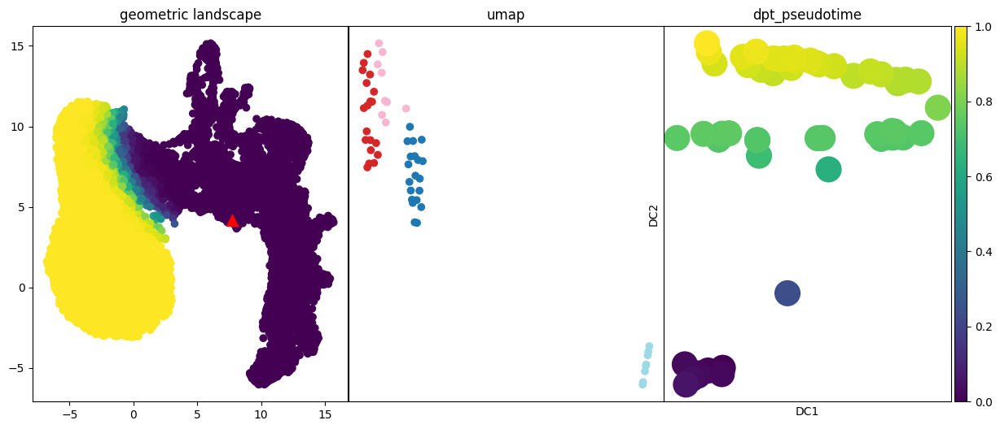

data/datacuration\GSE59114_1.csv


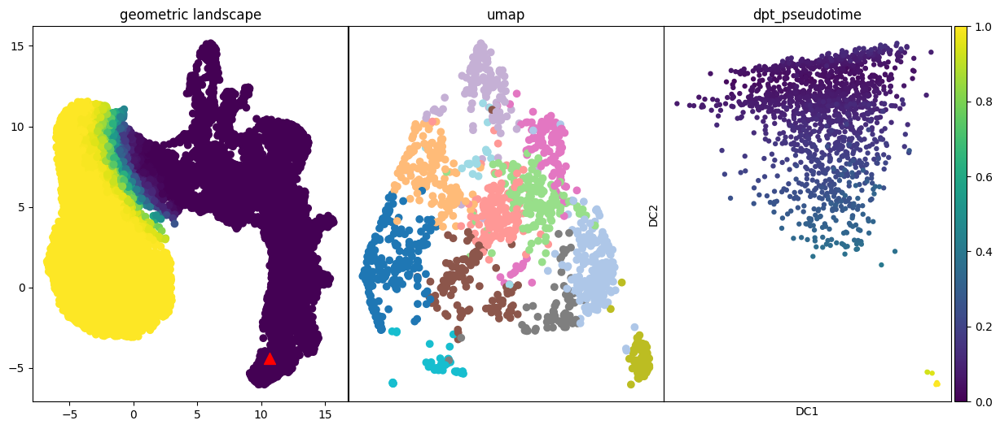

data/datacuration\GSE59114_2.csv


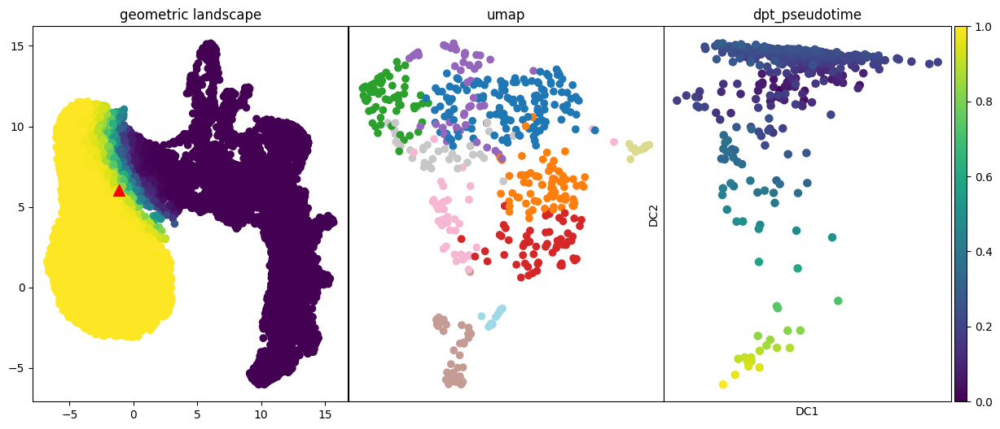

data/datacuration\GSE60361.csv


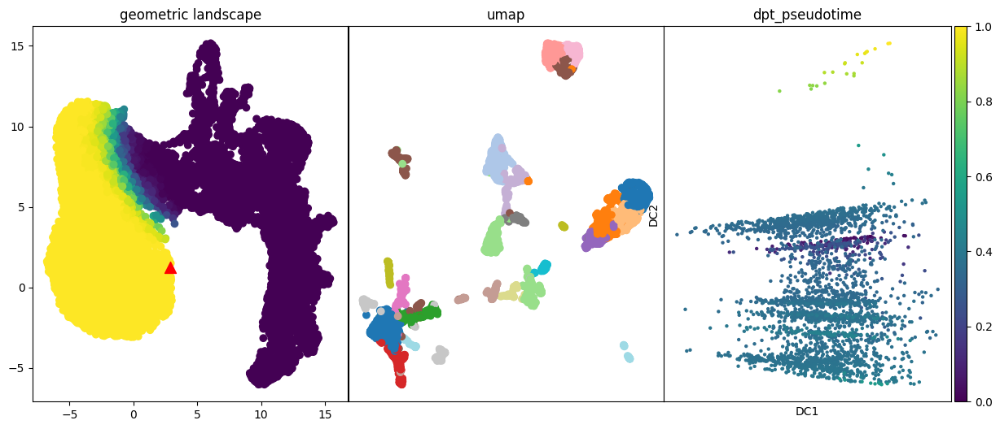

data/datacuration\GSE63818.csv


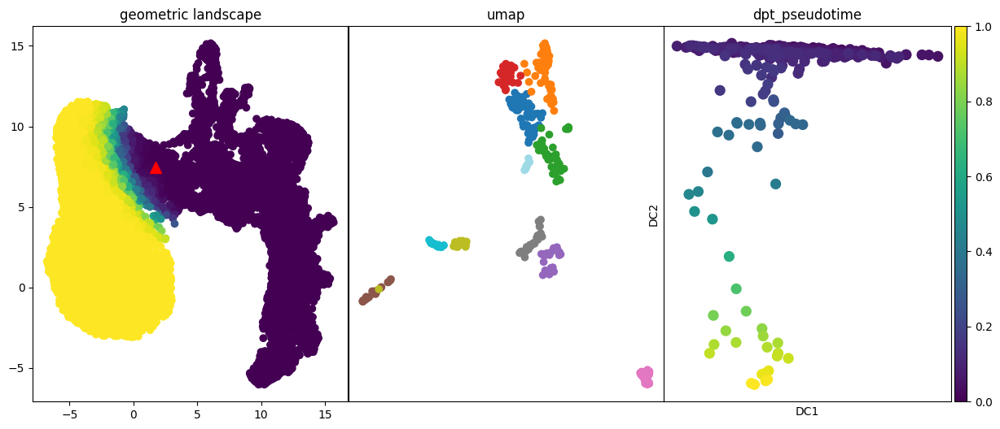

data/datacuration\GSE65525.csv


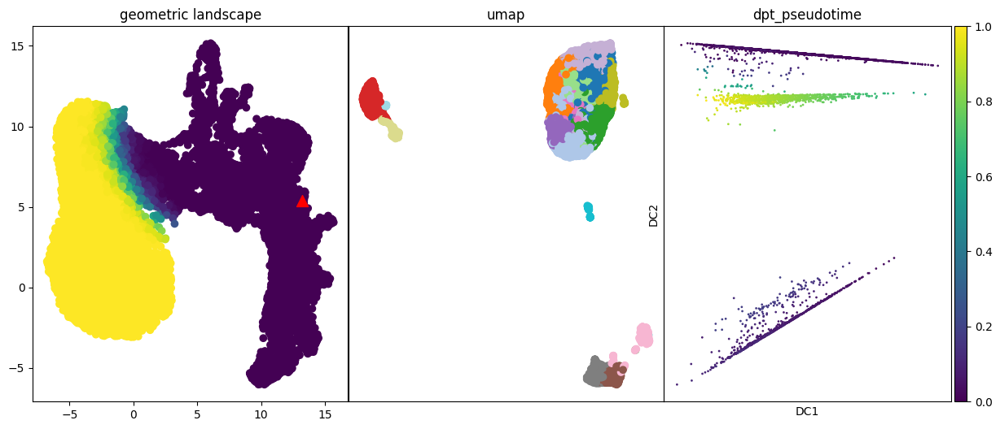

data/datacuration\GSE67835.csv


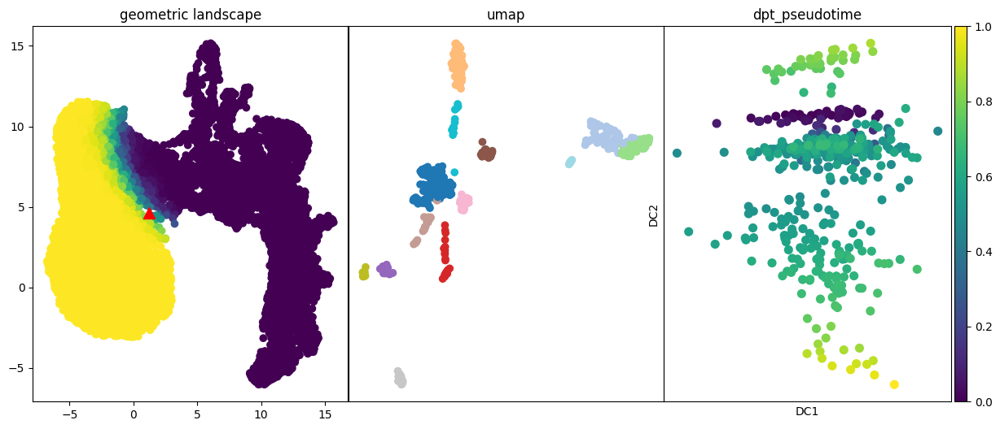

data/datacuration\GSE71585.csv


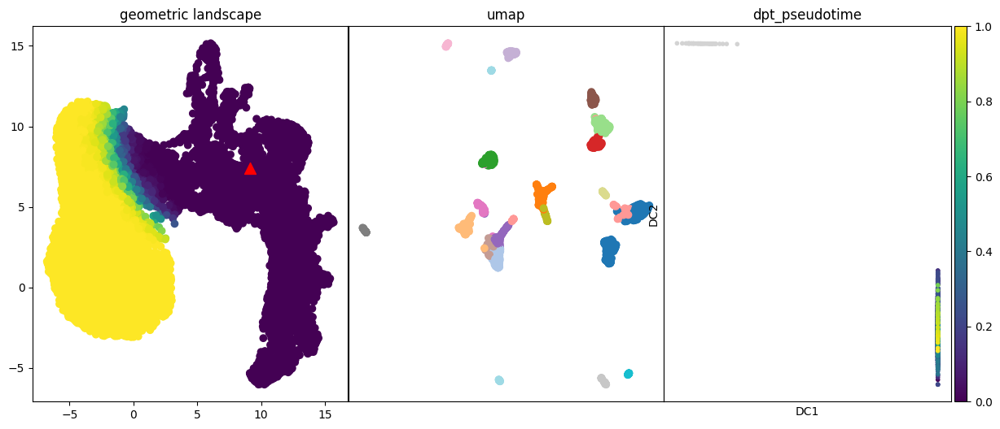

data/datacuration\GSE72056.csv


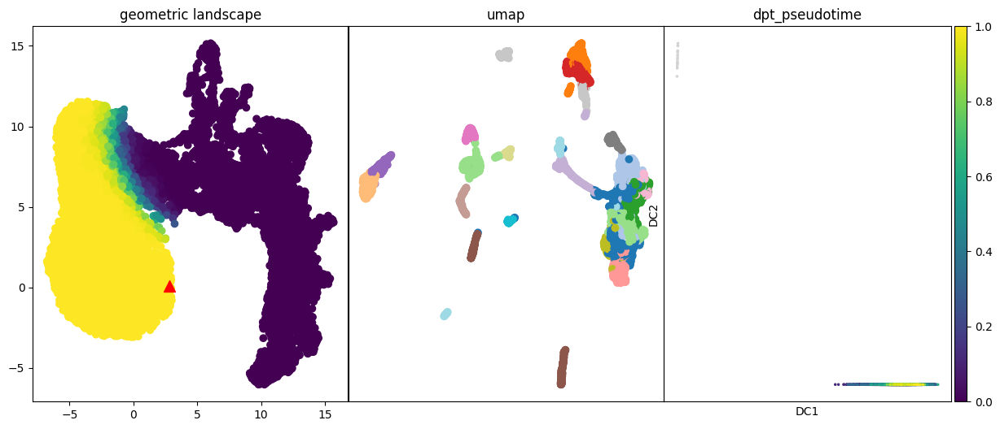

data/datacuration\GSE75140.csv


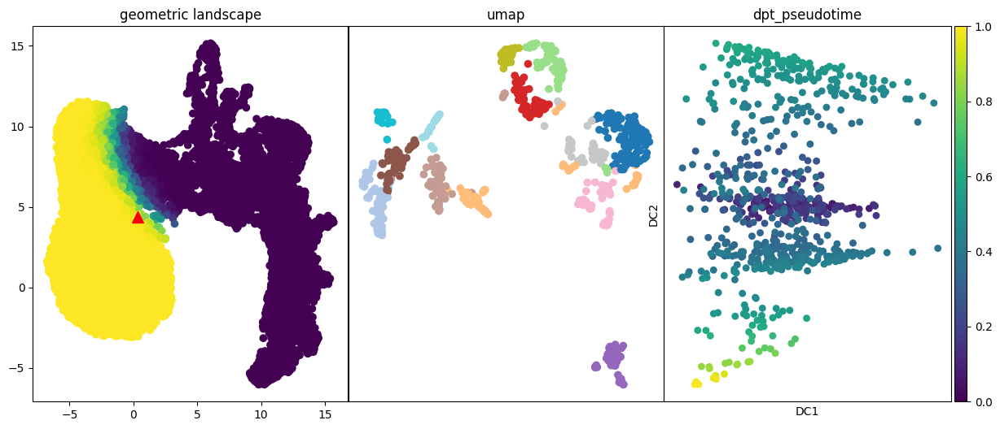

data/datacuration\GSE75748.csv


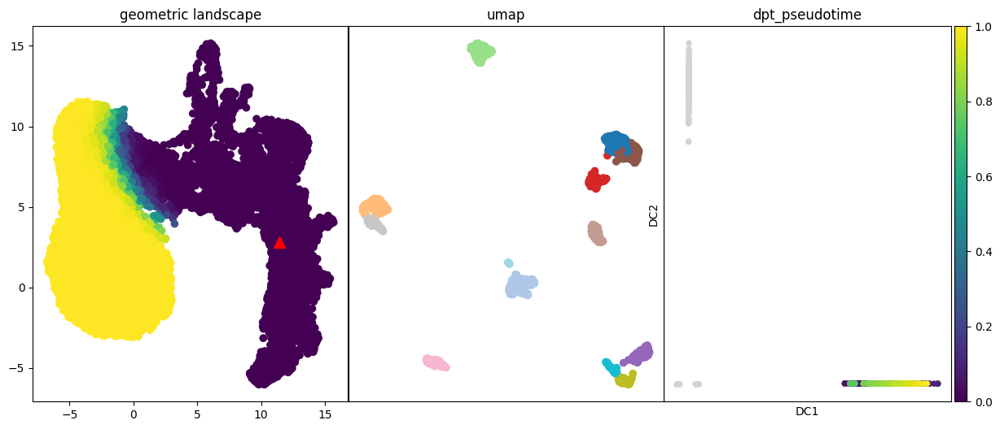

data/datacuration\GSE81608.csv


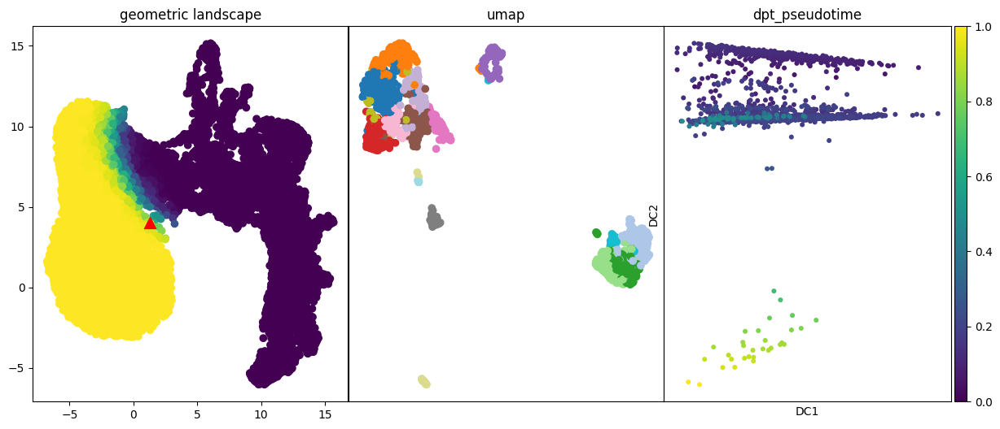

data/datacuration\GSE81861.csv


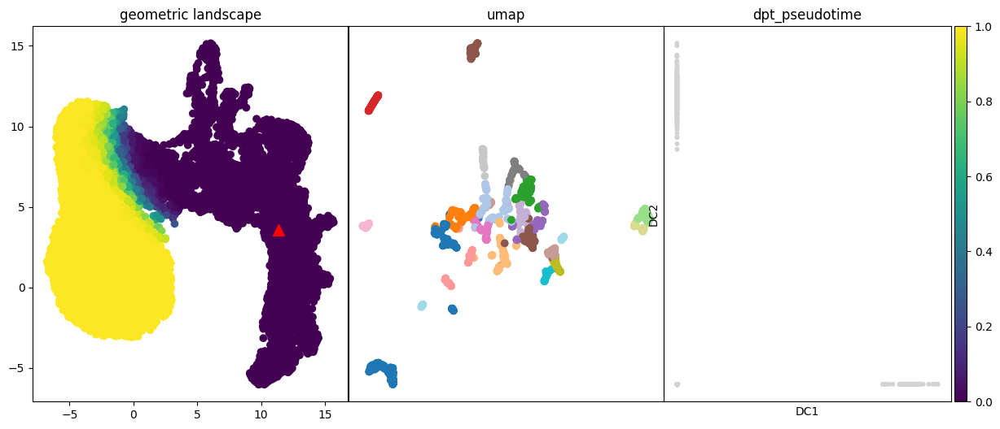

data/datacuration\GSE82187.csv


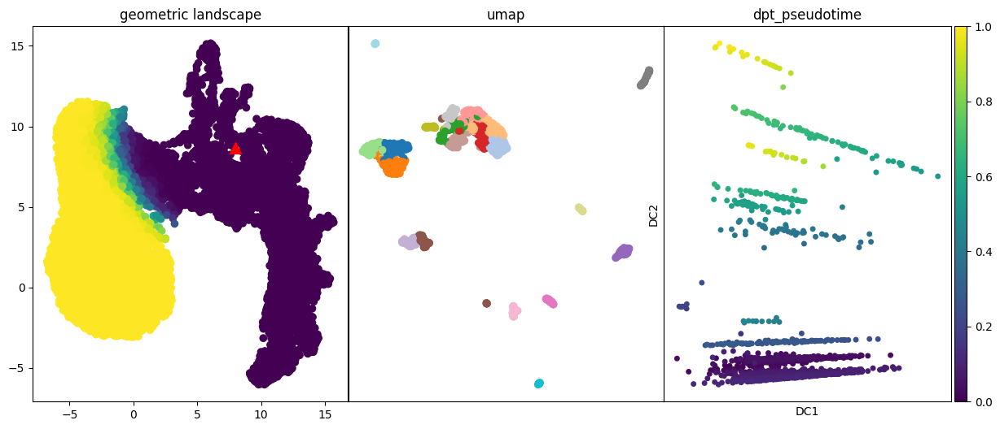

data/datacuration\GSE84143_1.csv


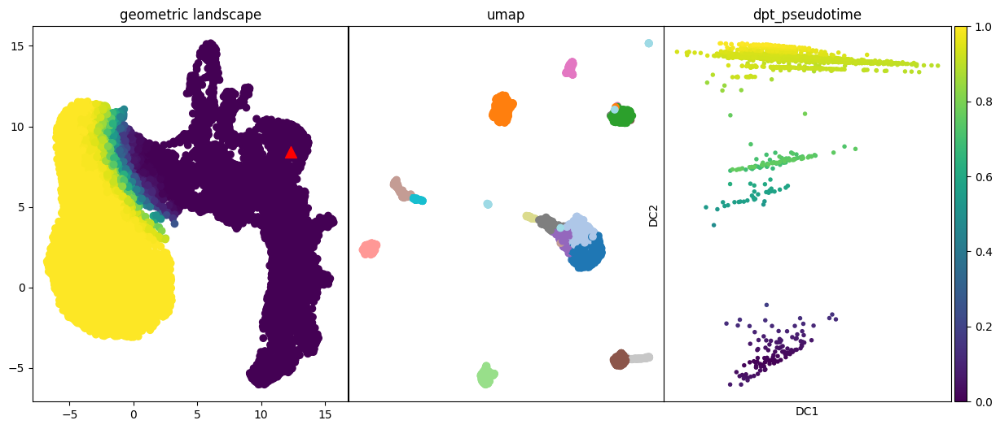

data/datacuration\GSE84143_2.csv


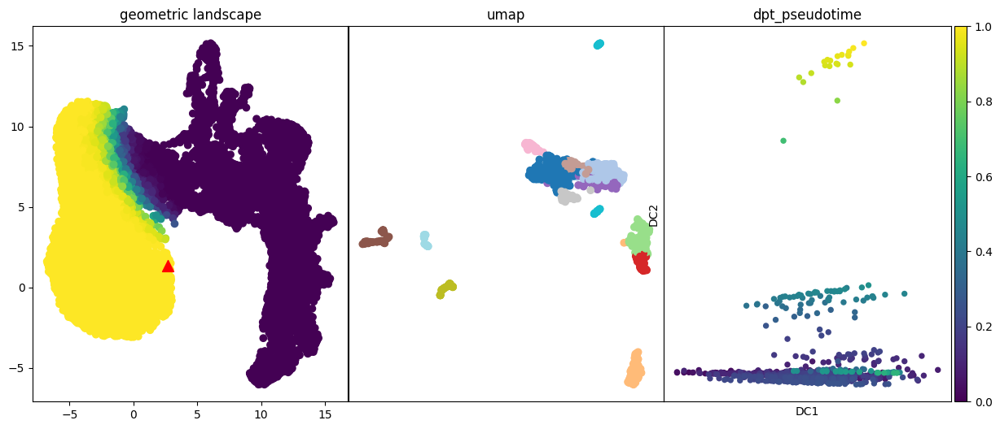

data/datacuration\GSE84143_3.csv


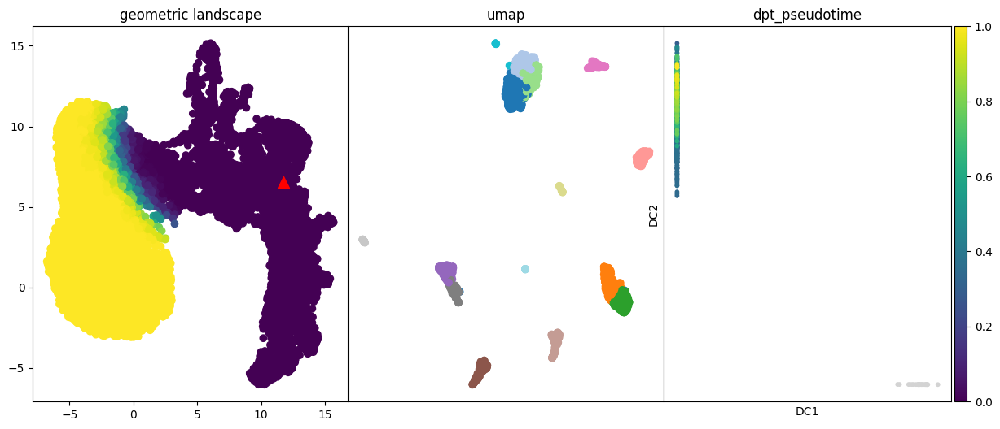

data/datacuration\GSE84143_4.csv


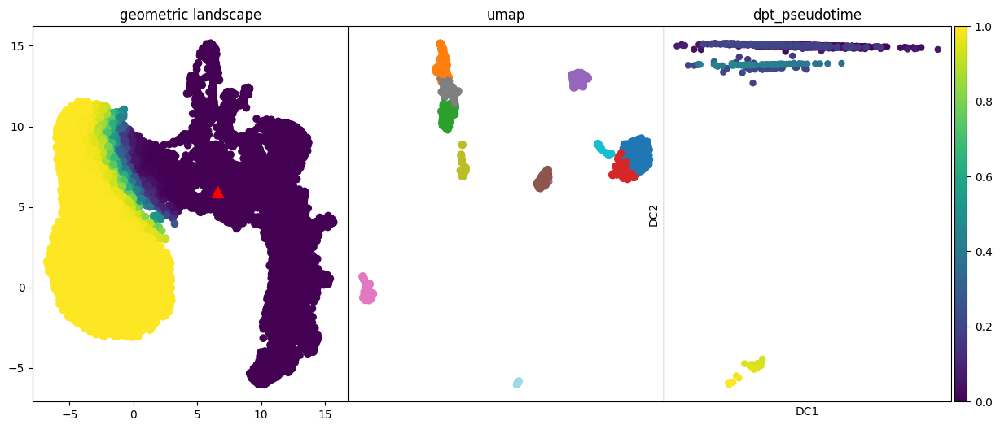

data/datacuration\GSE84143_5.csv


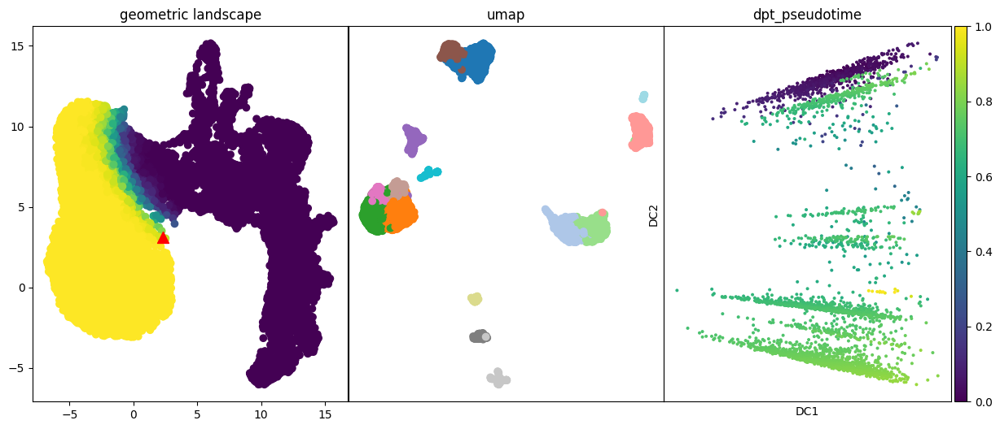

data/datacuration\GSE84143_6.csv


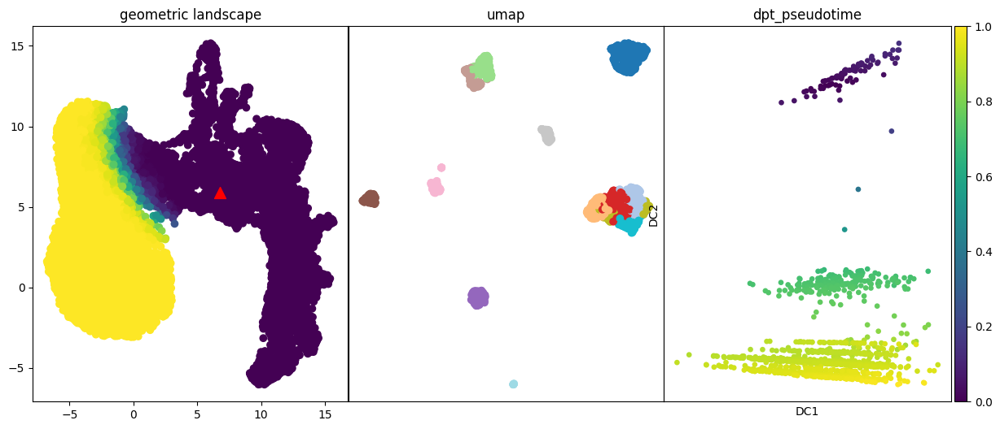

data/datacuration\GSE84371.csv


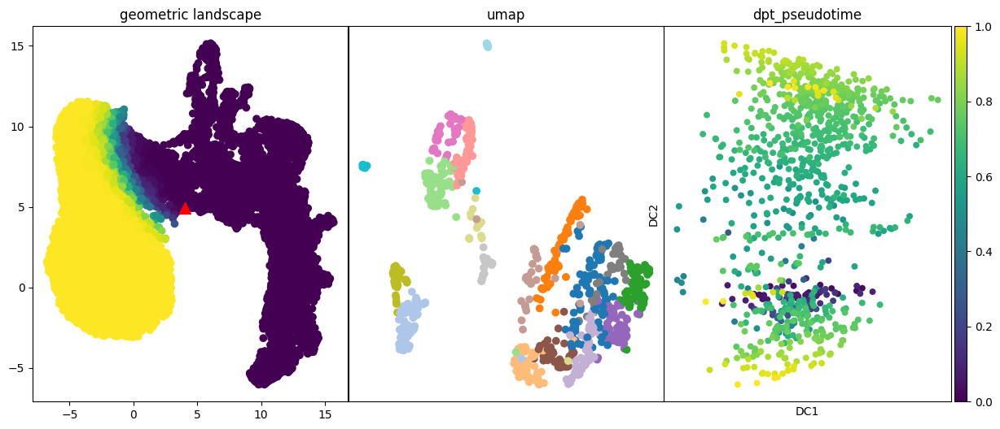

data/datacuration\GSE86146.csv


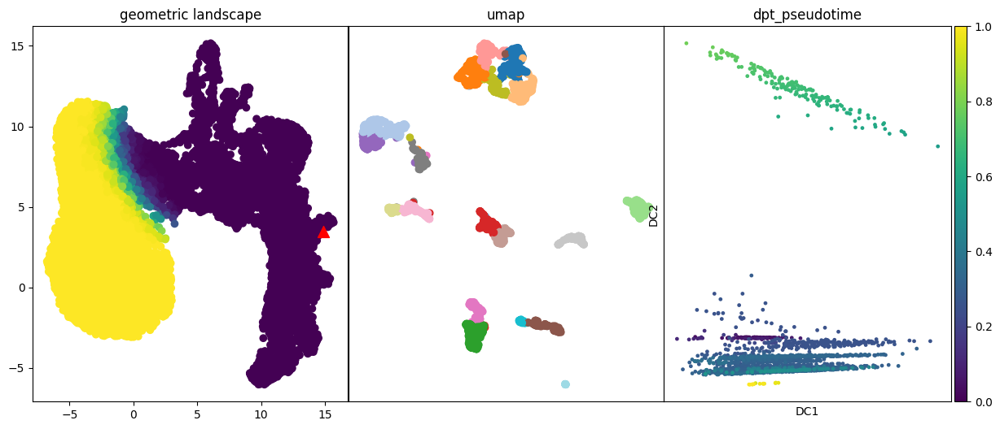

data/datacuration\GSE89232.csv


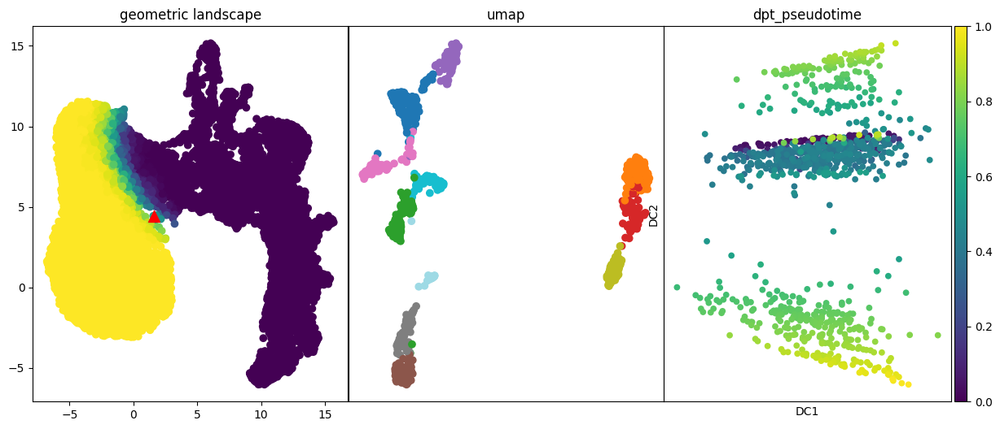

data/datacuration\GSE93593.csv


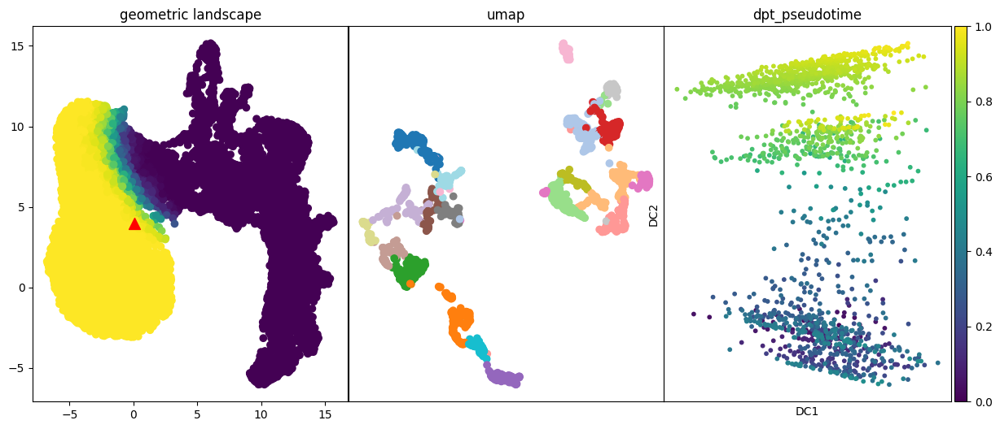

data/datacuration\GSE94820_1.csv


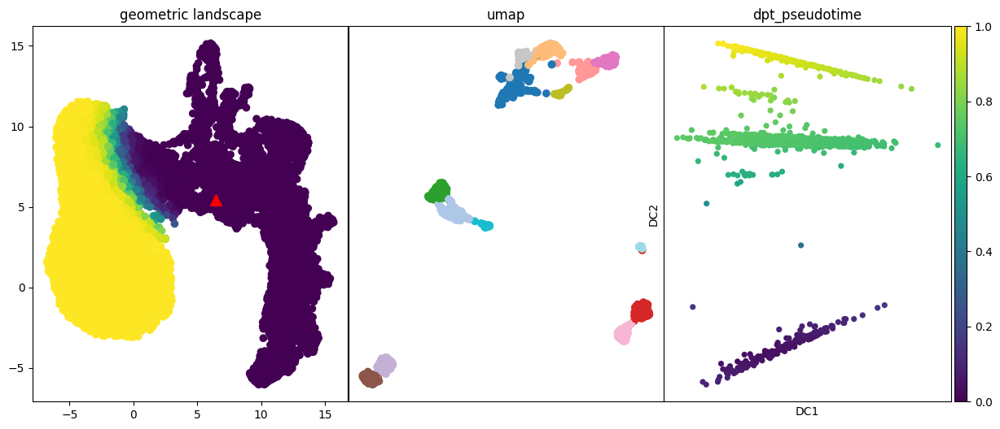

data/datacuration\GSE94820_2.csv


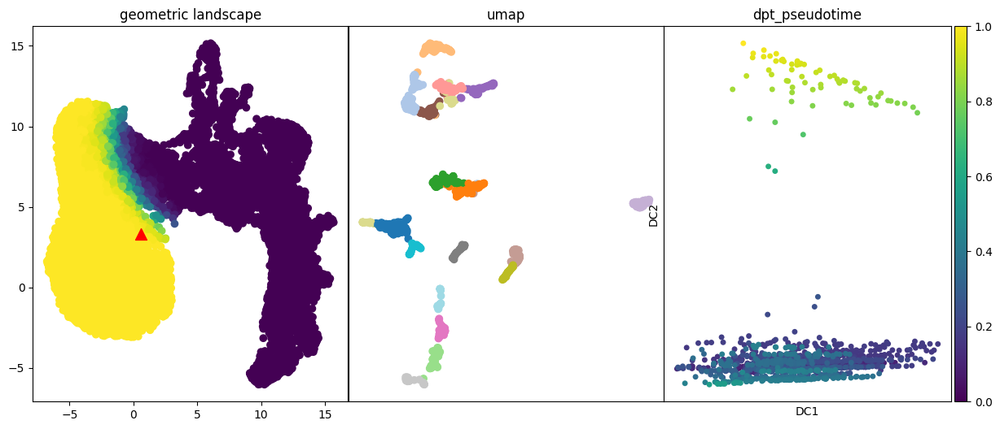

In [9]:
for file in glob.glob("data/datacuration/*.csv"):
    try:
        
        proj = coordinates[file.split('\\')[-1].split('.csv')[0]]
        fig, axs = plt.subplots(1,3, figsize=(15, 6), facecolor='w', edgecolor='k')
        fig.subplots_adjust(hspace = .5, wspace=.001)
        axs = axs.ravel()

        print(file)
        df = pd.read_csv(file, index_col=0)
        #df = preprocessing(np.array(df))
        data = np.array(df)
        data = AnnData(data)
        data.uns['iroot'] = 0 

        pca = PCA(n_components=20)
        embedding_pca = pca.fit_transform(df)
        A = kneighbors_graph(embedding_pca, 10, mode='connectivity', include_self=True)
        louvain = Louvain()
        labels = louvain.fit_transform(A)
        Umap = umap.UMAP()
        embedding_umap = Umap.fit_transform(embedding_pca)
        #fig = plt.figure(figsize=(5,5))
        axs[1].scatter(embedding_umap[:,0],embedding_umap[:,1],c=labels, alpha=1, cmap='tab20')
        axs[1].set_xticks([])
        axs[1].set_yticks([])
        axs[1].set_title('umap')

        axs[0].scatter(embedding[:,0],embedding[:,1], c = p, alpha = 1)
        axs[0].scatter(proj[0],proj[1], c = 'r', s = 100,  marker="^")
        axs[0].set_title('geometric landscape')

        #sp.set_figure_params(dpi=80, dpi_save=150, figsize=(5,5))
        sp.tl.pca(data, svd_solver='arpack')
        sp.pp.neighbors(data)
        sp.tl.diffmap(data)
        sp.tl.dpt(data)
        sp.pl.diffmap(data,color=['dpt_pseudotime'],ax=axs[2])  
    except:
        print('error occured for file {}'.format(file))
        continue